# Loading files

In [1]:
#!/usr/bin/env python
import sys, math
import matplotlib.pyplot as plt
import numpy as np
import glob
import random

import aux
import data_classes as dc
import myplot as mypl
import physics as ph

import multiprocessing as mp


inputpath = aux.COMMON_INPUT_PATH
outputpath = aux.COMMON_OUTPUT_PATH
dirLabel = mypl.dirLabel
muondatapath = aux.MUON_DATA_PATH
print(muondatapath)

/eos/user/l/lrygaard/ttalp/ttj_cluster_runs/


In [3]:
massLabels = [r"$m_a=50\,$MeV",r"$m_a=300\,$MeV",r"$m_a=1\,$GeV",r"$m_a=2\,$GeV",r"$m_a=3\,$GeV",
            r"$m_a=10\,$GeV",r"$m_a=20\,$GeV",r"$m_a=30\,$GeV",r"$m_a=50\,$GeV",r"$m_a=100\,$GeV"]
masses_org = [0.05,0.3,1,2,3,10,20,30,50,100]


#intlumi = 150 #fb-1
intlumi = 150*1000 #pb-1
# 1 fb = 0.001 pb -> 1 fb-1 = 1000 pb-1

# cross-sections in pb
cross_incl_org = [0.08800288, 0.0878576, 0.0923017, 0.09592004, 0.09589373000000001, 0.09378335999999998, 0.08844931999999998, 0.08216535999999999, 0.06951777000000002, 0.04509247499999999]
cross_boost_org = [0.0008085116, 0.0008088753, 0.0008235391, 0.0008374581999999999, 0.0008352221000000001, 0.0008106519, 0.0007637739, 0.0007116687000000001, 0.0006169515000000001, 0.00043018916]
cross_bkg_org = [0.017120891, 0.01883237, 0.02008674, 0.022096349999999997]
cross_ttj = 233.923699 #100000 gen events eta jet 3
cross_bkg_org.append(cross_ttj)
cross_ttmumu = [0.02206988]
cross_ttj_charge = [233.923699]

N_incl_org = []
N_boost_org = []
for i in range(len(masses_org)):
    N_incl_org.append(100000)
    N_boost_org.append(100000)
N_bkg_org = [100000,100000,100000,100000,100*100000]
N_ttj_charge = [100*100000]

cms = {"tracker": {"tl-2d": 20, "tl-z": 50, "r": 110, "z": 290, "eta": 2.4, "pT-mu": 4, "min_disp": 0.1},
       "muon": {"tl-2d": 200, "tl-z": 300, "r": 720, "z": 1050, "eta": 2.4, "pT-mu": 4, "min_disp": 0.1}}

labels_cwb = [r'inclusive $t\bar{t}$',r'boosted $t\bar{t}$']
labels_cwboth = [r'inclusive $t\bar{t}$',r'boosted $t\bar{t}$',r'background $t\bar{t}\mu\bar{\mu}$']
labels_bkg = [r'inclusive $t\bar{t}$',r'boosted $t\bar{t}$',r'background']
labels_incl_bkg = [r'inclusive $t\bar{t}$',r'background']

In [4]:
print("Reading files")
#Filenames of the lhe files we want to read in and sort them by ascending mass
filenames_inclusive=glob.glob(inputpath+"inclusive/ma*.lhe")
filenames_inclusive.sort()
filenames_inclusive.sort(key=len)

filenames_boosted=glob.glob(inputpath+"boosted/ma*.lhe")
filenames_boosted.sort()
filenames_boosted.sort(key=len)

filenames_bkg=glob.glob(inputpath+"Bkg/Bkg_*.lhe")
filenames_bkg.sort()
filenames_bkg.sort(key=len)

filenames_ttj=glob.glob("/eos/user/l/lrygaard/ttalp/ttj_cluster_runs/muon_data4/muon_data_*.txt")
filenames_ttj.sort()
filenames_ttj.sort(key=len)
print("   Done")

Reading files
   Done


In [5]:
# Read inout data with multiprocessing pool object
processes_num = 6
print(f"Loading data with {processes_num} processes")
# multiprocessing pool object
pool = mp.Pool()
# pool object with number of element
pool = mp.Pool(processes=5)
# map the function to the list and pass
# function and input list as arguments

Loading data with 6 processes
/eos/user/j/jalimena/TTALP/lhe_files/inclusive/ma003000.lhe read with [alp, top, antitop, muon, antimuon] in 100000 Events, where muons generated
/eos/user/j/jalimena/TTALP/lhe_files/inclusive/ma001000.lhe read with [alp, top, antitop, muon, antimuon] in 100000 Events, where muons generated
/eos/user/j/jalimena/TTALP/lhe_files/inclusive/ma002000.lhe read with [alp, top, antitop, muon, antimuon] in 100000 Events, where muons generated
/eos/user/j/jalimena/TTALP/lhe_files/inclusive/ma000300.lhe read with [alp, top, antitop, muon, antimuon] in 100000 Events, where muons generated
/eos/user/j/jalimena/TTALP/lhe_files/inclusive/ma000050.lhe read with [alp, top, antitop, electron, antielectron] in 100000 Events, where electrons generated
/eos/user/j/jalimena/TTALP/lhe_files/inclusive/ma010000.lhe read with [alp, top, antitop, muon, antimuon] in 100000 Events, where muons generated
/eos/user/j/jalimena/TTALP/lhe_files/inclusive/ma020000.lhe read with [alp, top, a

In [6]:
data_inclusive_input = pool.map(dc.Dataset.from_lhe_alp, filenames_inclusive)

In [7]:
#data_boosted_input = pool.map(dc.Dataset.from_lhe_alp, filenames_boosted)

In [7]:
data_bkg_input = pool.map(dc.Dataset.from_lhe_alp, filenames_bkg)

In [8]:
data_ttj_input = dc.Dataset.from_txt_bkg(muondatapath+"muon_data.txt")

/eos/user/l/lrygaard/ttalp/ttj_cluster_runs/muon_data.txt read with [top, antitop, muon, antimuon] in 192479 Events.


In [9]:
data_ttj_charge = [dc.Dataset.from_txt_bkg(muondatapath+"muon_data.txt",charge_req=-1)]

/eos/user/l/lrygaard/ttalp/ttj_cluster_runs/muon_data.txt read with [top, antitop, muon, antimuon] in 244411 Events.


In [10]:
data_bkg = data_bkg_input.copy()
data_bkg.append(data_ttj_input)
print(data_bkg)

[This Dataset contains 100000 events., This Dataset contains 100000 events., This Dataset contains 100000 events., This Dataset contains 100000 events., This Dataset contains 192479 events.]


# Make a cut for |eta|<2.5

In [11]:
# Saving original version of data before making the first cut on eta
data_inclusive_nocut = data_inclusive_input.copy()
#data_boosted_nocut = data_boosted_input.copy()
data_bkg_nocut = data_bkg.copy()
data_ttj_charge_nocut = data_ttj_charge.copy()

In [12]:
# Make a cut for |eta|<2.5
sel = ((lambda x: abs(x)<2.5),"eta", ["muon"])
data_inclusive = [dc.Dataset.event_selection(ds,sel) for ds in data_inclusive_nocut]
#data_boosted = [dc.Dataset.event_selection(ds,sel) for ds in data_boosted_nocut]
data_bkg = [dc.Dataset.event_selection(ds,sel) for ds in data_bkg_nocut]
data_ttj_charge =[dc.Dataset.event_selection(ds,sel) for ds in data_ttj_charge_nocut]
sel = ((lambda x: abs(x)<2.5),"eta", ["antimuon"])
data_inclusive = [dc.Dataset.event_selection(ds,sel) for ds in data_inclusive]
#data_boosted = [dc.Dataset.event_selection(ds,sel) for ds in data_boosted]
data_bkg = [dc.Dataset.event_selection(ds,sel) for ds in data_bkg]
data_bkg_ttj_charge = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_charge]


data_inclusive_org = data_inclusive.copy()
#data_boosted_org = data_boosted.copy()
data_bkg_org = data_bkg.copy()
data_ttj_charge_org = data_ttj_charge.copy()
print(data_inclusive)
#print(data_boosted)
print(data_bkg)
print(data_ttj_charge)

[This Dataset contains 96370 events., This Dataset contains 96389 events., This Dataset contains 96294 events., This Dataset contains 96144 events., This Dataset contains 96010 events., This Dataset contains 94845 events., This Dataset contains 93859 events., This Dataset contains 93410 events., This Dataset contains 92648 events., This Dataset contains 92323 events.]
[This Dataset contains 100000 events., This Dataset contains 100000 events., This Dataset contains 100000 events., This Dataset contains 91173 events., This Dataset contains 87671 events.]
[This Dataset contains 144002 events.]


# Functions

In [13]:
def get_expected_events(datasets, cross_sections, intlumi, N_tot):
    if len(datasets) != len(cross_sections):
        print("Error: len(datasets) != len(cross_sections)")
    if len(datasets) != len(N_tot):
        print("Error: len(datasets) != len(N_tot)")
    else:
        for i in range(len(datasets)):
            n = len(datasets[i].events)*cross_sections[i]*intlumi/N_tot[i]
            sigma_n = math.sqrt(len(datasets[i].events))*cross_sections[i]*intlumi/N_tot[i]             
            print("Expected number of events: ", n, " +- ", sigma_n)
            
def get_figure_of_merit(signal, signal_cross, signal_N, background, background_cross, background_N, intlumi):
    nS = len(signal.events)*signal_cross*intlumi/signal_N
    nB = 0
    sigmaB2 = 0
    for i in range(len(background)):
        nB += len(background[i].events)*background_cross[i]*intlumi/background_N[i]
        sigmaBi = math.sqrt(len(background[i].events))*background_cross[i]*intlumi/background_N[i]
        sigmaB2 += sigmaBi*sigmaBi
    sigmaB = math.sqrt(sigmaB2)
    s = nS/math.sqrt(nS+nB+sigmaB)
    return s

In [14]:
def data(which, whose, where, **kwargs):
    """calculates a specific observable for a specific dataset
    
    which - the observable calculated (e.g.: "pT", "theta", "oA")
    whose - list of the particle's converned (e.g.: ["alp"], ["top", "antitop"])
    where - the dataset used (e.g. "incl"); to return only a single dataset's 
       observable data, set where = ("incl", 3) for the 4th dataset in "incl"
    additional arguments for the observable function can be placed in kwargs
    if we want the average instead of the full dataset, add average=True"""
    if where == "incl":
        return [ds.observables(which, whose, **kwargs) for ds in data_inclusive]
    elif where == "boost":
        return [ds.observables(which, whose, **kwargs) for ds in data_boosted]
    elif where == "bkg":
        return [ds.observables(which, whose, **kwargs) for ds in data_bkg]
    elif where == "ttmumu":
        return [ds.observables(which, whose, **kwargs) for ds in data_ttmumu]
    elif where == "ttmumu2":
        return [ds.observables(which, whose, **kwargs) for ds in data_ttmumu2]
    elif where == "ttj":
        return [data_ttj.observables(which, whose, **kwargs)]
    elif where == "ttj_c":
        return [ds.observables(which, whose, **kwargs) for ds in data_ttj_charge]
    elif where == "ttj_masscheck":
        return [ds.observables(which, whose, **kwargs) for ds in data_ttj_masscheck]
    elif where == "ttj_pairs":
        return [ds.observables(which, whose, **kwargs) for ds in data_ttj_pairs]
    elif len(where)==2:
        if where[0] == "incl":
            return data_inclusive[where[1]].observables(which, whose, **kwargs)
        elif where[0] == "boost":
            return data_boosted[where[1]].observables(which, whose, **kwargs)
        elif where[0] == "bkg":
            return data_bkg[where[1]].observables(which, whose, **kwargs)
        elif where[0] == "ttmumu":
            return data_ttmumu[where[1]].observables(which, whose, **kwargs)
        elif where[0] == "ttmumu2":
            return data_ttmumu2[where[1]].observables(which, whose, **kwargs)
        elif where[0] == "ttj_c":
            return data_ttj_charge[where[1]].observables(which, whose, **kwargs)
        elif where[0] == "ttj_masscheck":
            return data_ttj_masscheck[where[1]].observables(which, whose, **kwargs)
        elif where[0] == "ttj_pairs":
            return data_ttj_pairs[where[1]].observables(which, whose, **kwargs)
    else:
        raise ValueError(f"Dataset-List {where} not defined.")

In [15]:
def plot_raw_events(massLabels, customXlabels, labels_ttj, selLabel):
    mypl.hist1dcomp2(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),[],massLabels,dirLabel["mmumu"],customXlabels=customXlabels,nbins=120,customXlim=[0,120],log_scale=True,selLabel=selLabel)
    mypl.hist1dcomp2(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),[],massLabels,dirLabel["mmumu"],customXlabels=customXlabels,nbins=100,customXlim=[0,50],log_scale=True,selLabel=selLabel)
    mypl.hist1dcomp2(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"ttj_c"),[],massLabels,dirLabel["mmumu"],customXlabels=labels_ttj,nbins=120,customXlim=[0,120],log_scale=True,selLabel=selLabel,title=title_charge)

    mypl.hist1dcomp2(data("pT",["muon"],"incl"),data("pT",["muon"],"bkg"),[],massLabels,dirLabel["pT_mu"],customXlim=[0,1000],customXlabels=customXlabels,log_scale=True,selLabel=selLabel)
    mypl.hist1dcomp2(data("pT",["muon"],"incl"),data("pT",["muon"],"bkg"),[],massLabels,dirLabel["pT_mu"],nbins=100,customXlim=[0,100],customXlabels=customXlabels,log_scale=True,selLabel=selLabel)
    mypl.hist1dcomp2(data("pT",["muon"],"incl"),data("pT",["muon"],"ttj_c"),[],massLabels,dirLabel["pT_mu"],customXlabels=labels_ttj,customXlim=[0,100],log_scale=True,selLabel=selLabel,title=title_charge)

    mypl.hist1dcomp2(data("eta",["muon"],"incl"),data("eta",["muon"],"bkg"),[],massLabels,dirLabel["eta_mu"],customXlabels=customXlabels,customXlim=[-2.5,2.5],log_scale=True,selLabel=selLabel)
    mypl.hist1dcomp2(data("eta",["muon"],"incl"),data("eta",["muon"],"ttj_c"),[],massLabels,dirLabel["eta_mu"],customXlabels=labels_ttj,customXlim=[-2.5,2.5],log_scale=True,selLabel=selLabel,title=title_charge)

    mypl.hist1dcomp2(data("deltaR",["antimuon","muon"],"incl"),data("deltaR",["antimuon","muon"],"bkg"),[],massLabels,dirLabel["deltaR_muons"],customXlim=[0,5],customXlabels=customXlabels,log_scale=True,selLabel=selLabel,clip=True)
    mypl.hist1dcomp2(data("deltaR",["antimuon","muon"],"incl"),data("deltaR",["antimuon","muon"],"ttj_c"),[],massLabels,dirLabel["deltaR_muons"],customXlim=[0,5],customXlabels=labels_ttj,log_scale=True,selLabel=selLabel,title=title_charge,clip=True)

    mypl.hist1dcomp2(data("oA",["antimuon","muon"],"incl"),data("oA",["antimuon","muon"],"bkg"),[],massLabels,dirLabel["oA_muons"],customXlabels=customXlabels,nbins=90,customXlim=[0,180],log_scale=True,selLabel=selLabel)
    mypl.hist1dcomp2(data("oA",["antimuon","muon"],"incl"),data("oA",["antimuon","muon"],"ttj_c"),[],massLabels,dirLabel["oA_muons"],customXlabels=labels_ttj,nbins=90,customXlim=[0,180],log_scale=True,selLabel=selLabel,title=title_charge)

    mypl.hist1dcomp2(data("y",["muon"],"incl"),data("y",["muon"],"bkg"),[],massLabels,dirLabel["y_mu"],customXlabels=customXlabels,log_scale=True,selLabel=selLabel)
    mypl.hist1dcomp2(data("y",["muon"],"incl"),data("y",["muon"],"ttj_c"),[],massLabels,dirLabel["y_mu"],customXlabels=labels_ttj,log_scale=True,selLabel=selLabel,title=title_charge)


In [22]:
def plot_weighted_events(cross_incl,cross_bkg,N_incl,N_bkg,intlumi,massLabels,labels,labels_ttj,selLabel):
    mypl.hist1dcross(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["mmumu"],customXlabels=labels,nbins=120,customXlim=[0,120],log_scale=True,selLabel=selLabel)
    mypl.hist1dcross(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["mmumu"],customXlabels=labels,nbins=100,customXlim=[0,50],log_scale=True,selLabel=selLabel)
    mypl.hist1dcross(data("inv_mass",["antimuon","muon"],"incl"),data("inv_mass",["antimuon","muon"],"ttj_c"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["mmumu"],customXlabels=labels_ttj,nbins=120,customXlim=[0,120],log_scale=True,selLabel=selLabel)

    mypl.hist1dcross(data("pT",["muon"],"incl"),data("pT",["muon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["pT_mu"],customXlabels=labels,customXlim=[0,1000],log_scale=True,selLabel=selLabel)
    mypl.hist1dcross(data("pT",["muon"],"incl"),data("pT",["muon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["pT_mu"],customXlabels=labels,nbins=100,customXlim=[0,100],log_scale=True,selLabel=selLabel)
    mypl.hist1dcross(data("pT",["muon"],"incl"),data("pT",["muon"],"ttj_c"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["pT_mu"],customXlabels=labels_ttj,nbins=100,customXlim=[0,100],log_scale=True,selLabel=selLabel)

    mypl.hist1dcross(data("eta",["muon"],"incl"),data("eta",["muon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["eta_mu"],customXlabels=labels,customXlim=[-2.5,2.5],log_scale=True,selLabel=selLabel)
    mypl.hist1dcross(data("eta",["muon"],"incl"),data("eta",["muon"],"ttj_c"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["eta_mu"],customXlabels=labels_ttj,customXlim=[-2.5,2.5],log_scale=True,selLabel=selLabel)

    mypl.hist1dcross(data("deltaR",["antimuon","muon"],"incl"),data("deltaR",["antimuon","muon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["deltaR_muons"],customXlim=[0,5],customXlabels=labels,log_scale=True,selLabel=selLabel,clip=True)
    mypl.hist1dcross(data("deltaR",["antimuon","muon"],"incl"),data("deltaR",["antimuon","muon"],"ttj_c"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["deltaR_muons"],customXlim=[0,5],customXlabels=labels_ttj,log_scale=True,selLabel=selLabel,clip=True)

    mypl.hist1dcross(data("oA",["antimuon","muon"],"incl"),data("oA",["antimuon","muon"],"bkg"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["oA_muons"],customXlabels=labels,nbins=90,customXlim=[0,180],log_scale=True,selLabel=selLabel)
    mypl.hist1dcross(data("oA",["antimuon","muon"],"incl"),data("oA",["antimuon","muon"],"ttj_c"),[],cross_incl,cross_bkg,[],N_incl,N_bkg,[],intlumi,massLabels,dirLabel["oA_muons"],customXlabels=labels_ttj,nbins=90,customXlim=[0,180],log_scale=True,selLabel=selLabel)

# Plotting

### Removing some of the data samples for cleaner plots

In [16]:
data_inclusive = []
data_inclusive.append(data_inclusive_org[2]) # 1 GeV
data_inclusive.append(data_inclusive_org[5]) # 10 GeV
data_inclusive.append(data_inclusive_org[8]) # 50 GeV
data_inclusive.append(data_inclusive_org[9]) # 100 GeV
data_bkg = []
data_bkg.append(data_bkg_org[2]) # ttmumu Bkg_3
data_bkg.append(data_bkg_org[4]) # ttj

cross_incl = []
cross_incl.append(cross_incl_org[2])
cross_incl.append(cross_incl_org[5])
cross_incl.append(cross_incl_org[8])
cross_incl.append(cross_incl_org[9])
cross_bkg = []
cross_bkg.append(cross_bkg_org[2])
cross_bkg.append(cross_bkg_org[4])

N_incl = [100000,100000,100000,100000]
N_bkg = [100000,100*100000]

print(data_inclusive)
print(data_bkg)
print(data_ttj_charge)
get_expected_events(data_inclusive, cross_incl, intlumi, N_incl)
get_expected_events(data_bkg, cross_bkg, intlumi, N_bkg)
get_expected_events(data_ttj_charge, cross_ttj_charge, intlumi, N_ttj_charge)

massLabels2 = [r"$m_a=1\,$GeV",r"$m_a=10\,$GeV",r"$m_a=50\,$GeV",r"$m_a=100\,$GeV"]
masses2 = [1,10,50,100]
labels2 = [r'background $t\bar{t}\mu\bar{\mu}$', r'background $t\bar{t}j$']
labels_ttj = [r'background $t\bar{t}j$']
title_charge = "No muon charge requirement"

selLabel = [r"$|\eta_{\mu}|$ < 2.5"]

[This Dataset contains 96294 events., This Dataset contains 94845 events., This Dataset contains 92648 events., This Dataset contains 92323 events.]
[This Dataset contains 100000 events., This Dataset contains 87671 events.]
[This Dataset contains 144002 events.]
Expected number of events:  13332.149849700001  +-  42.96359090757059
Expected number of events:  13342.324168799996  +-  43.323573099859914
Expected number of events:  9661.023532440004  +-  31.739867955603216
Expected number of events:  6244.608854137499  +-  20.551819942768102
Expected number of events:  3013.011  +-  9.527977375141589
Expected number of events:  307624.869225435  +-  1038.947164057959
Expected number of events:  505282.20755097  +-  1331.5262841709618


Different array lengths: 4, 2, 0, 4


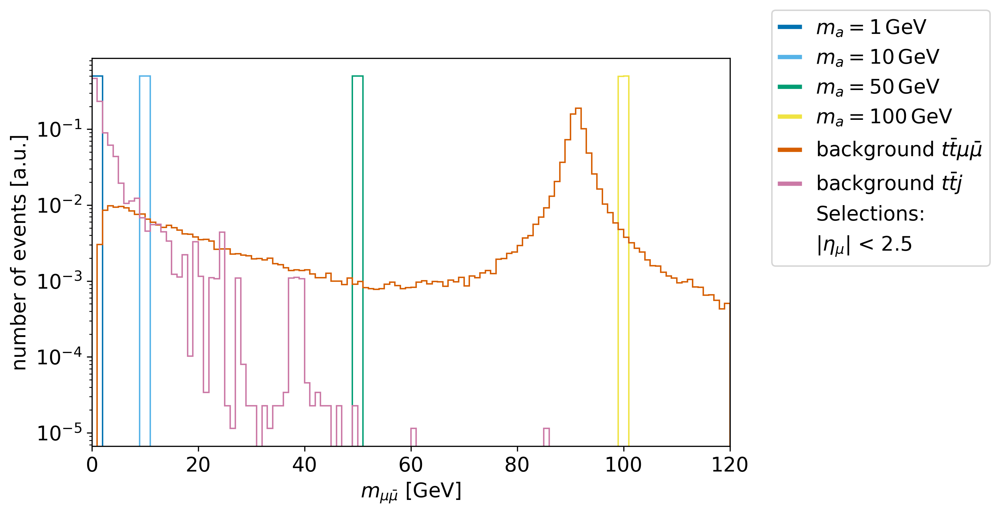

Different array lengths: 4, 2, 0, 4


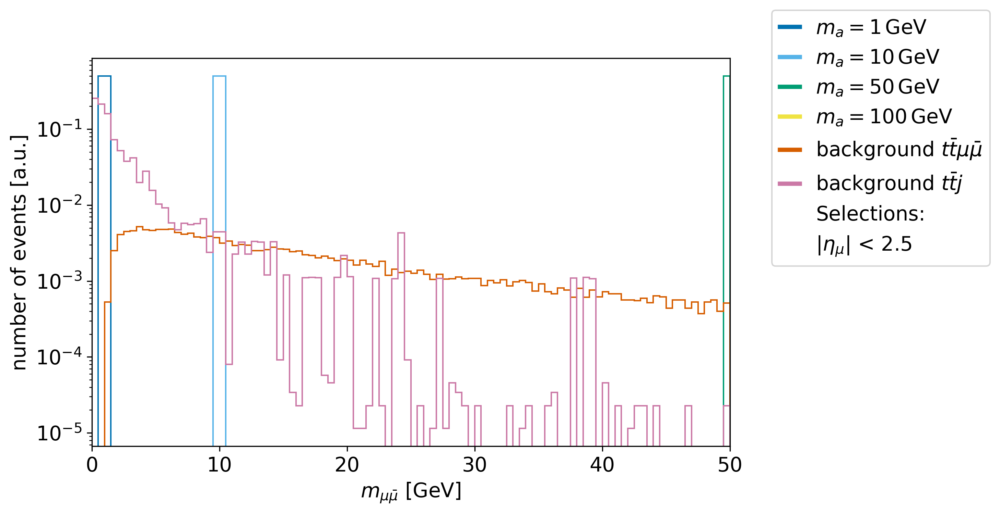

Different array lengths: 4, 1, 0, 4


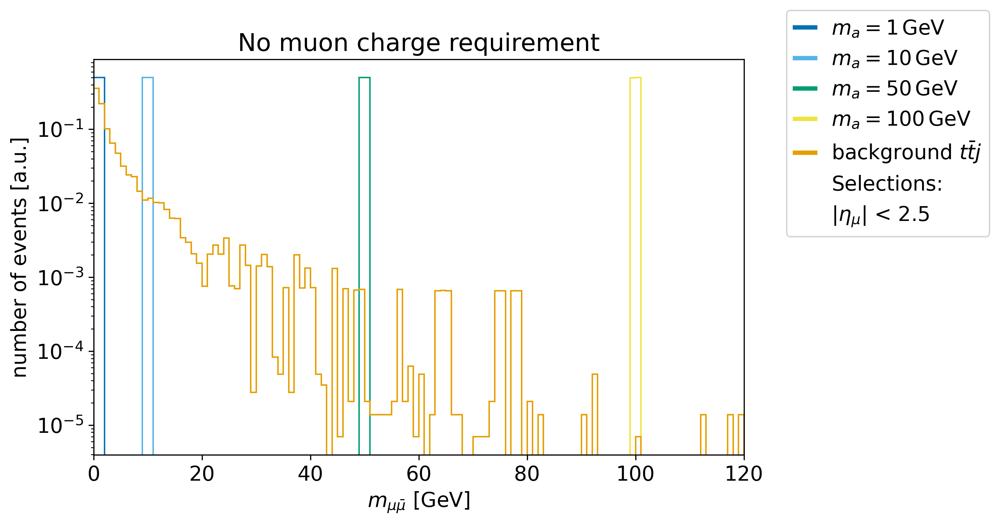

Different array lengths: 4, 2, 0, 4


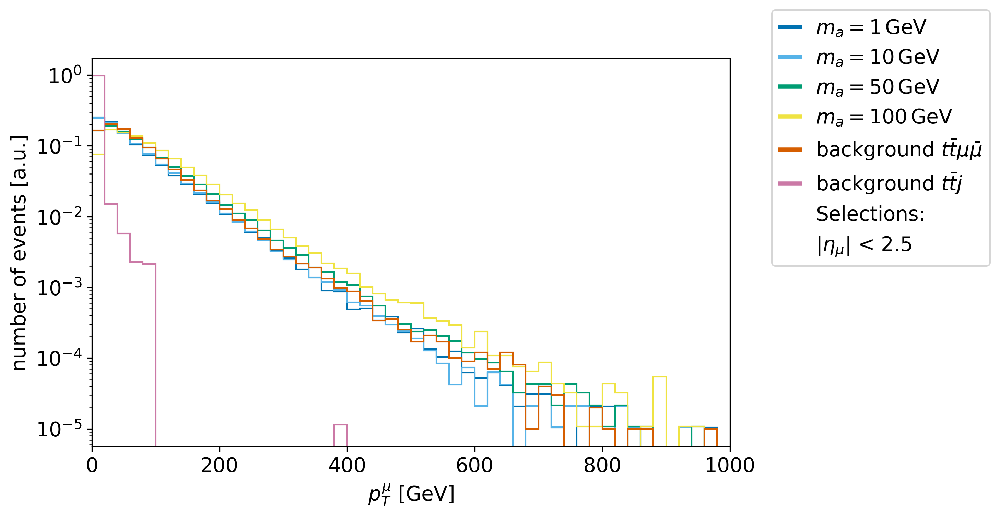

Different array lengths: 4, 2, 0, 4


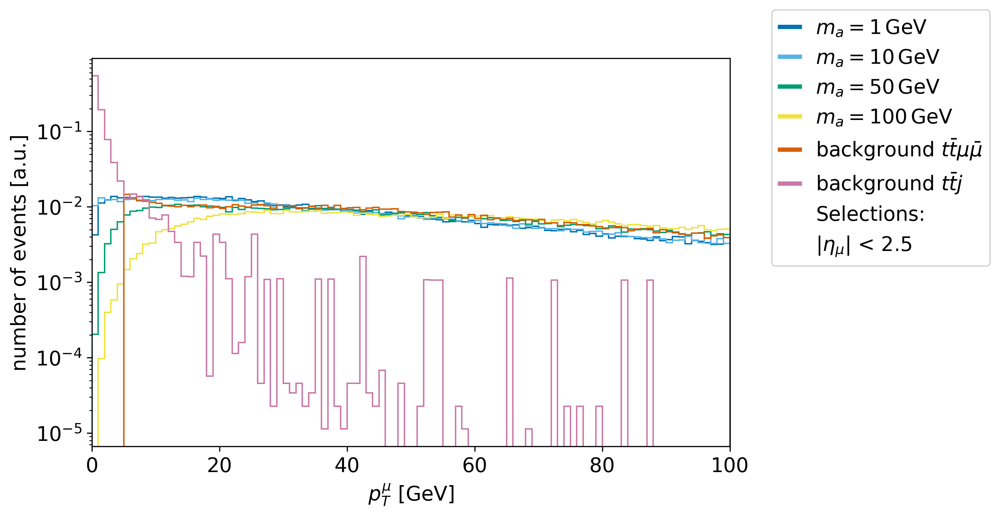

Different array lengths: 4, 1, 0, 4


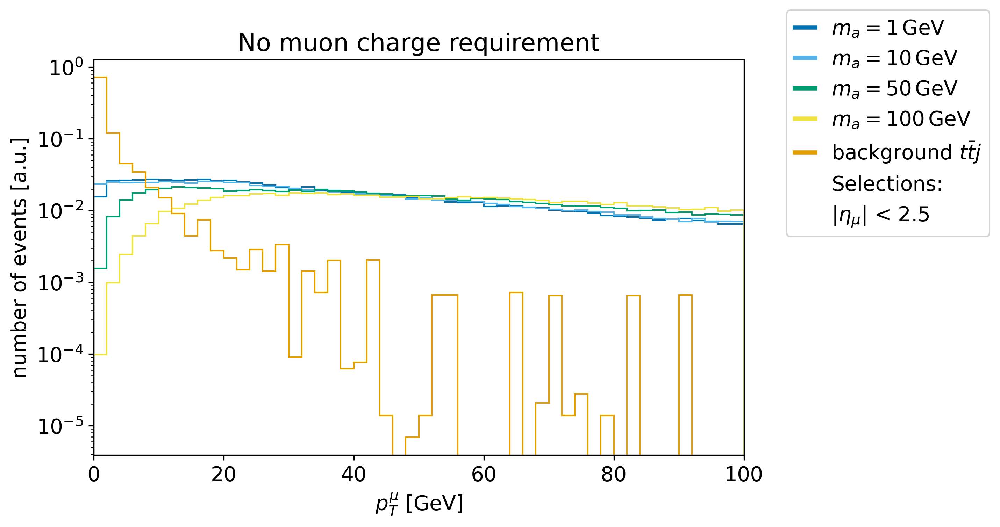

Different array lengths: 4, 2, 0, 4


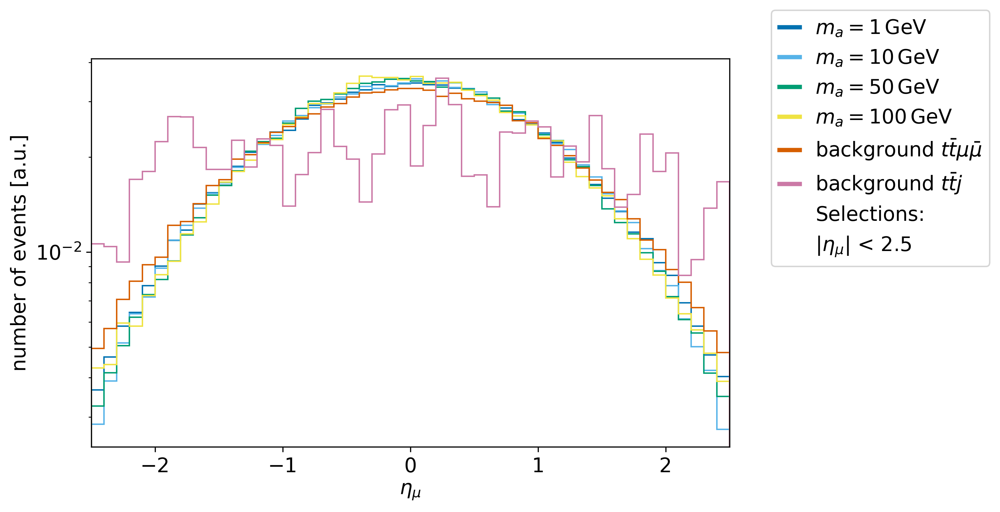

Different array lengths: 4, 1, 0, 4


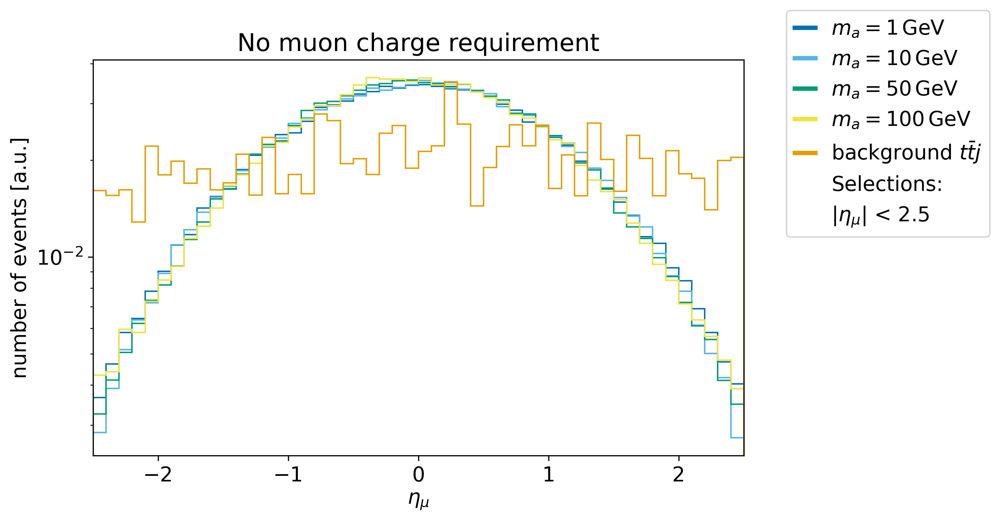

Different array lengths: 4, 2, 0, 4


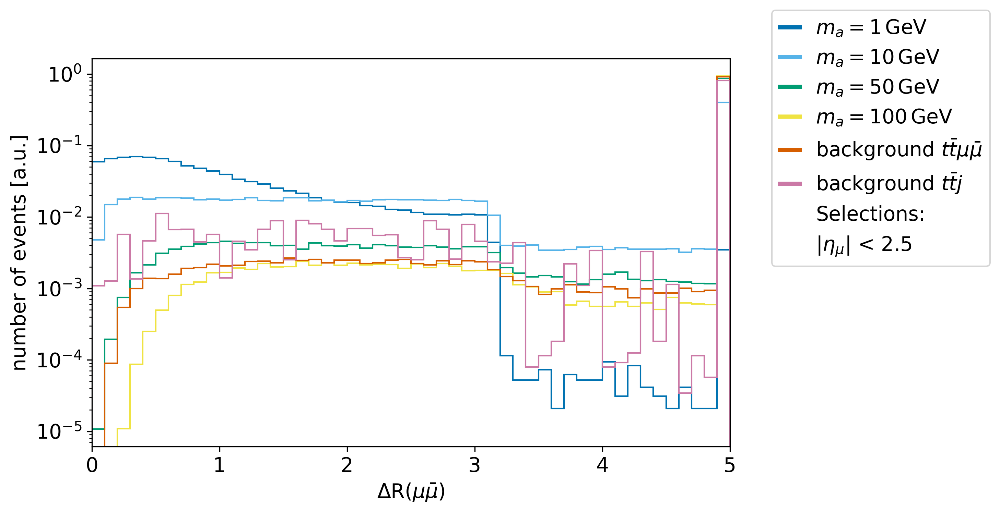

Different array lengths: 4, 1, 0, 4


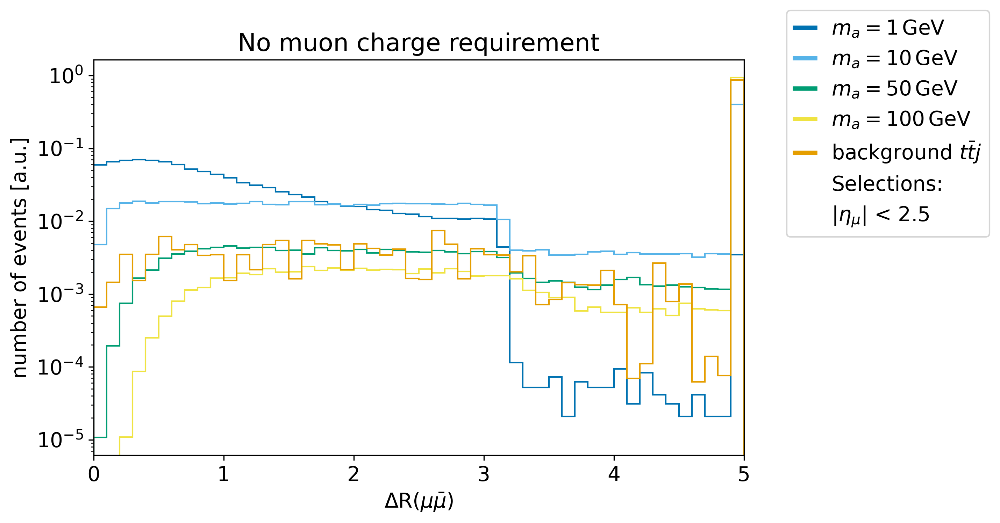

Different array lengths: 4, 2, 0, 4


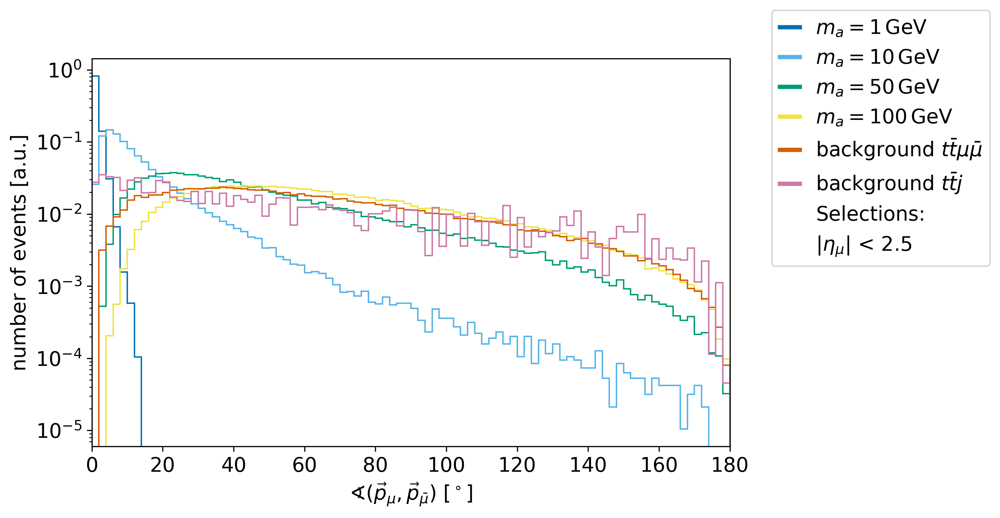

Different array lengths: 4, 1, 0, 4


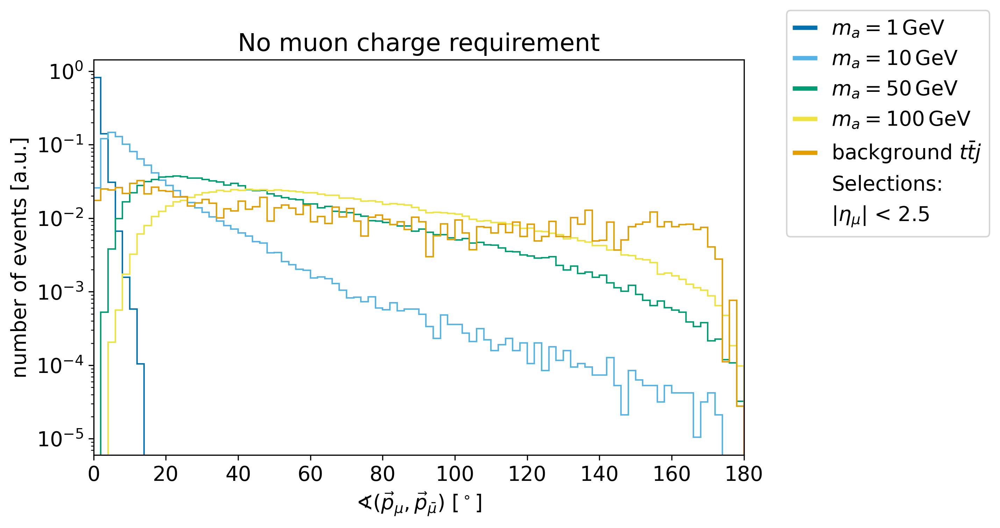

Different array lengths: 4, 2, 0, 4


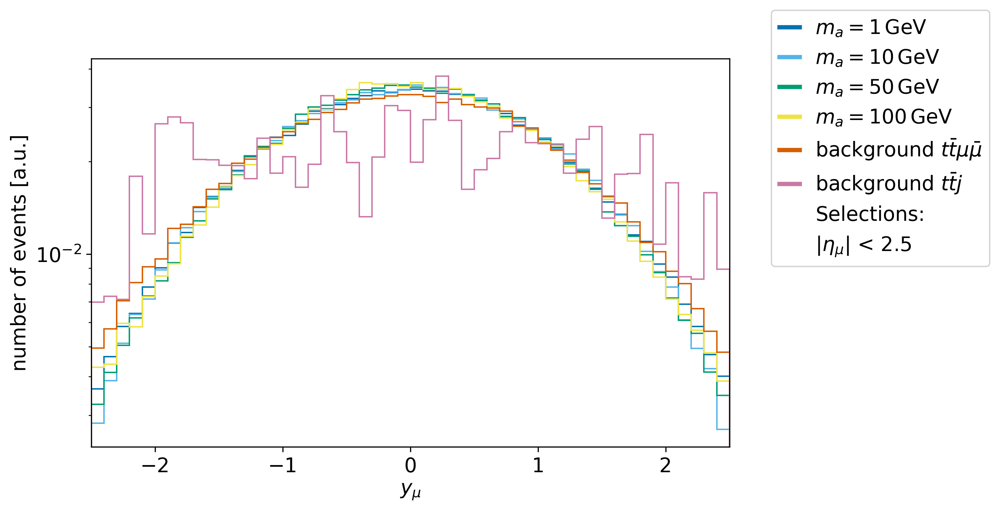

Different array lengths: 4, 1, 0, 4


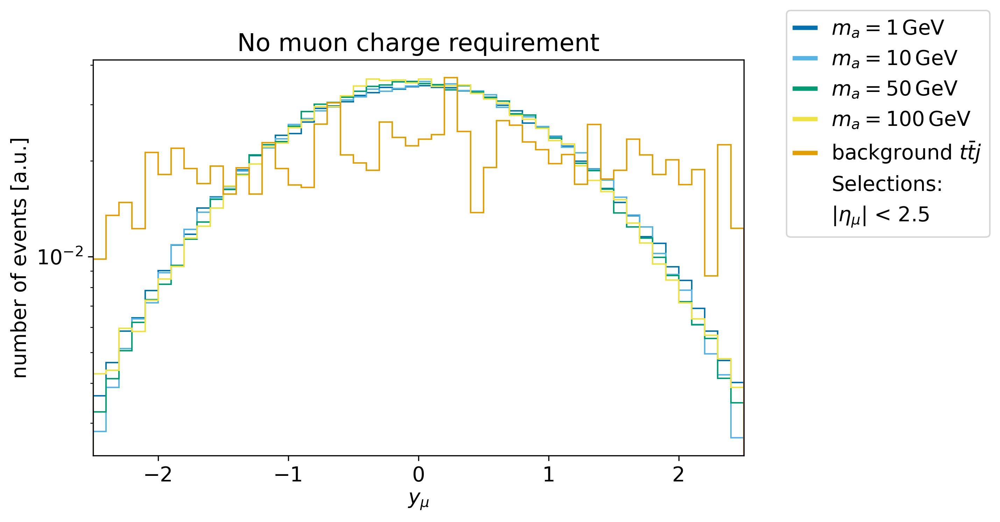

In [17]:
plot_raw_events(massLabels2, labels2, labels_ttj, selLabel)

Different array lengths: 4, 2, 0, 4


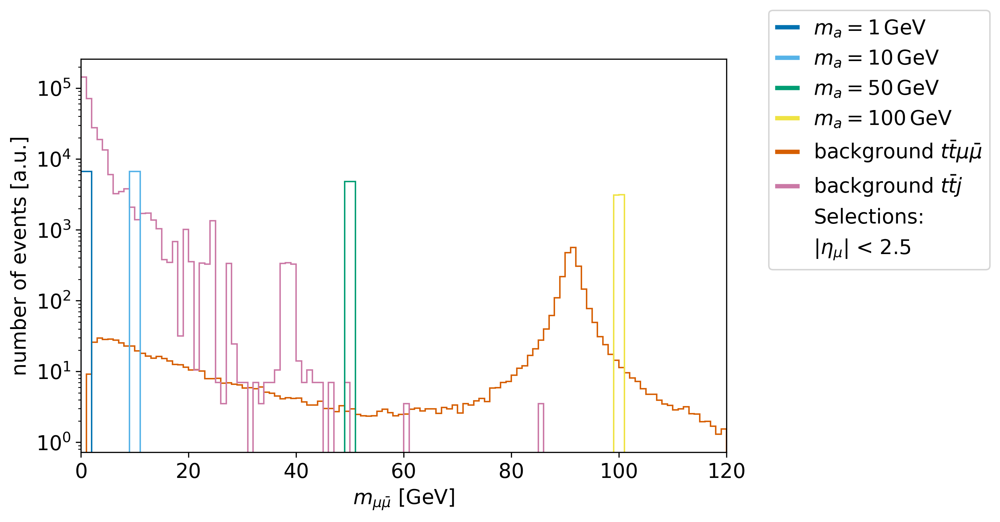

Different array lengths: 4, 2, 0, 4


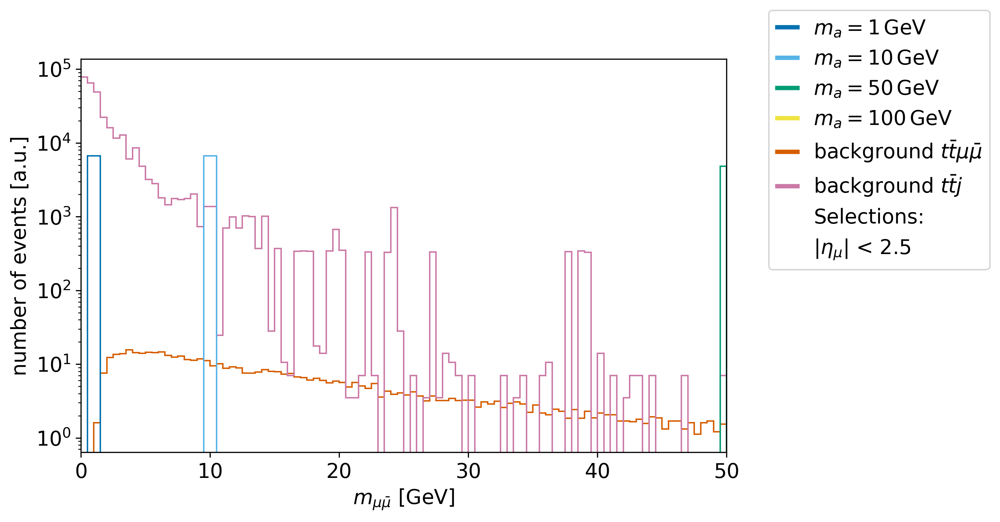

Different array lengths: 4, 1, 0, 4


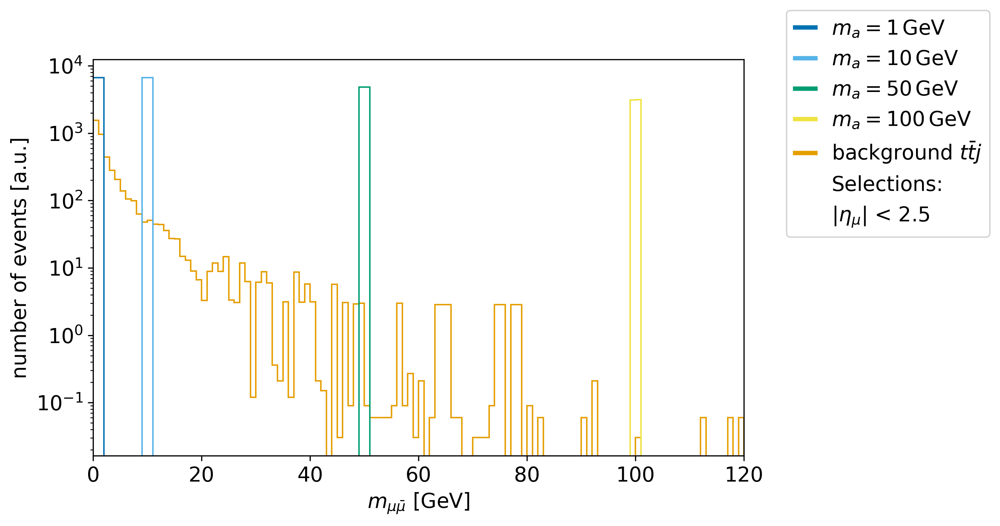

Different array lengths: 4, 2, 0, 4


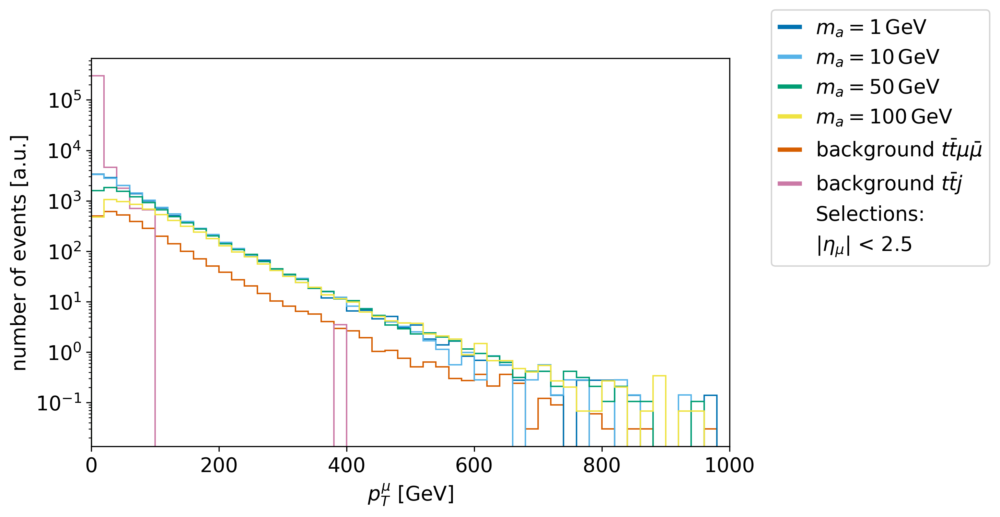

Different array lengths: 4, 2, 0, 4


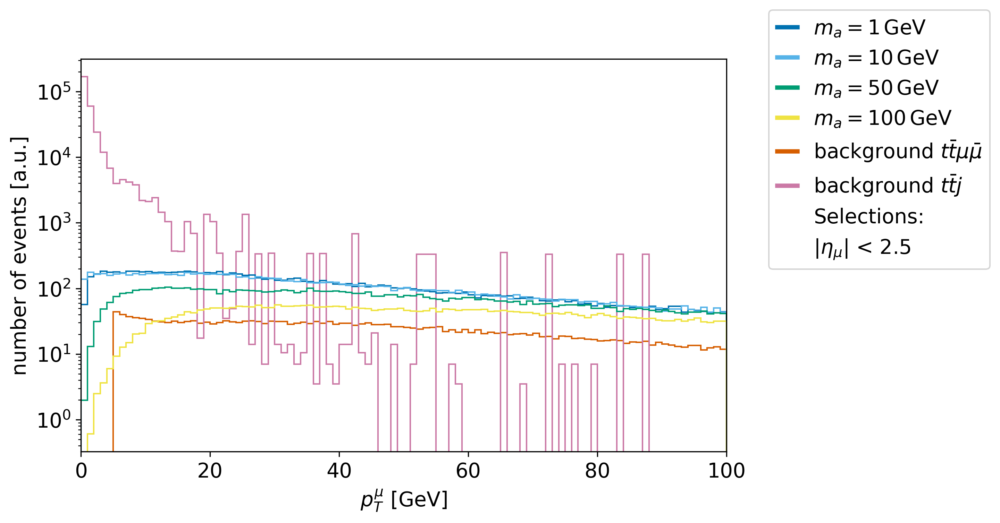

Different array lengths: 4, 1, 0, 4


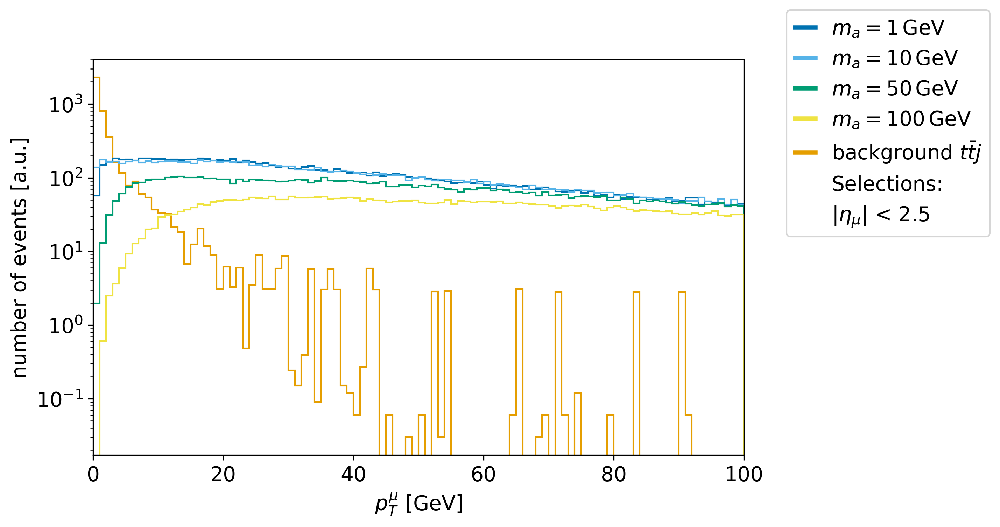

Different array lengths: 4, 2, 0, 4


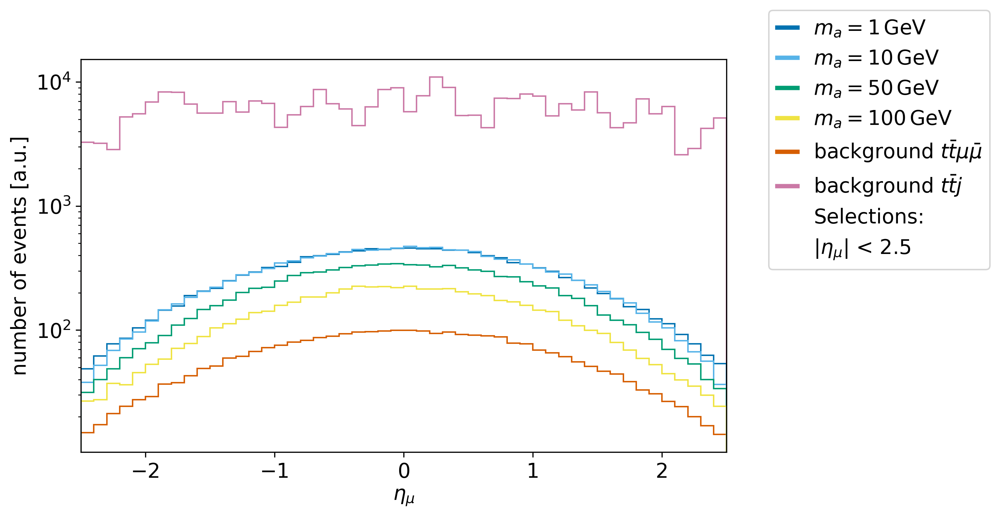

Different array lengths: 4, 1, 0, 4


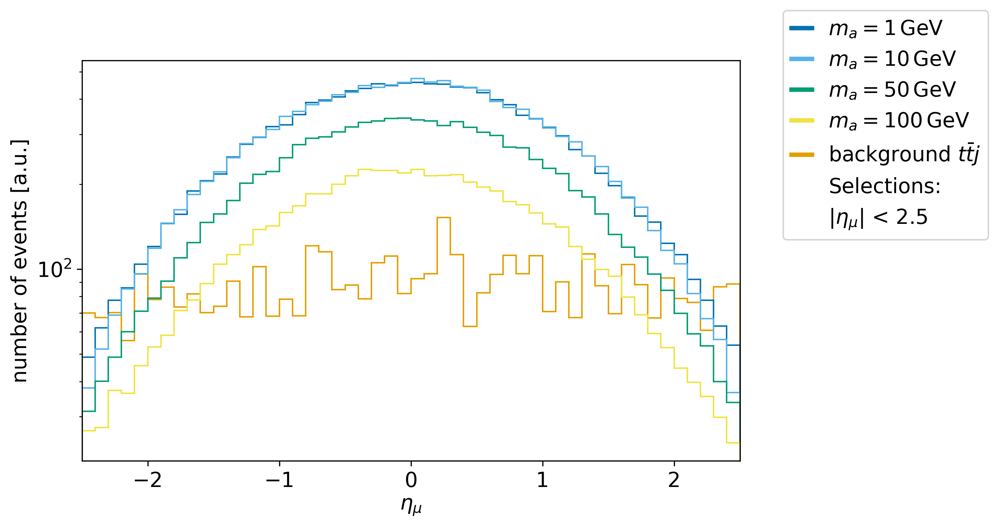

Different array lengths: 4, 2, 0, 4


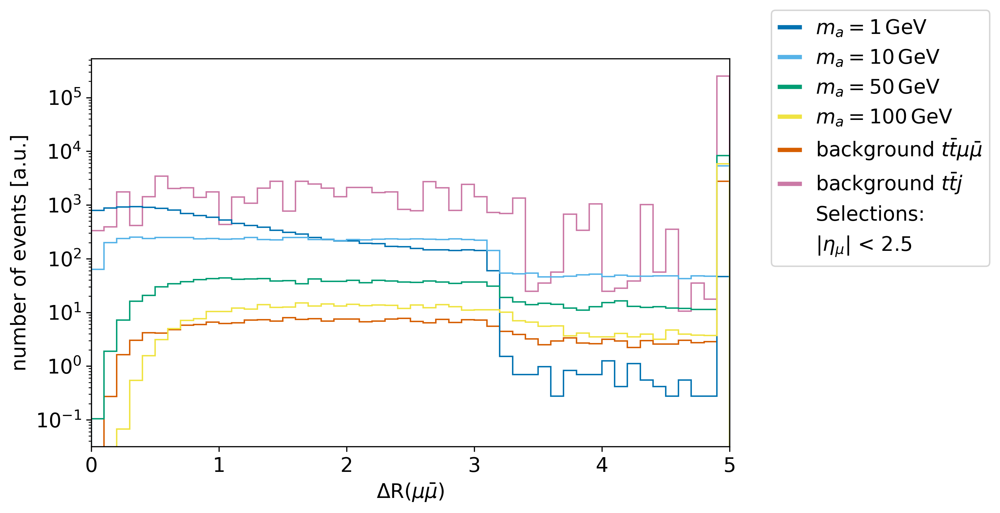

Different array lengths: 4, 1, 0, 4


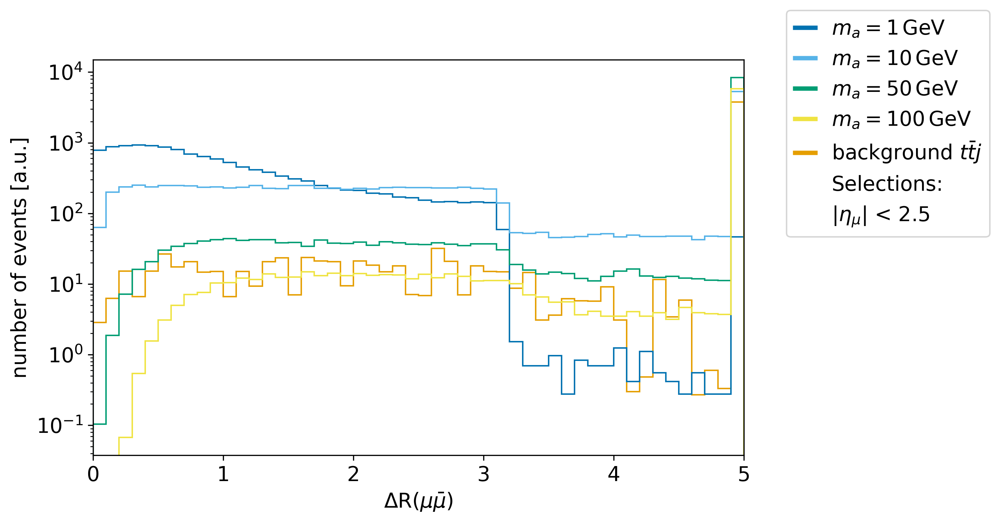

Different array lengths: 4, 2, 0, 4


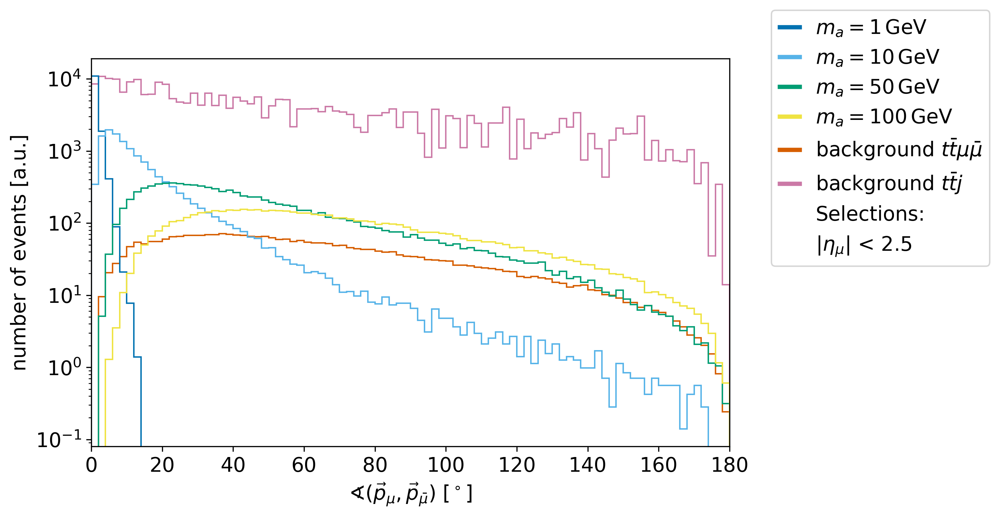

Different array lengths: 4, 1, 0, 4


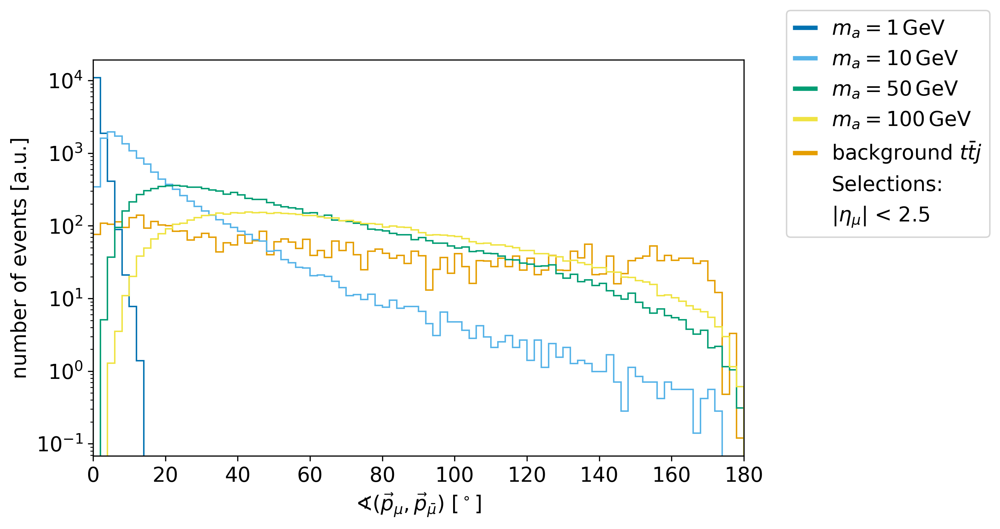

In [23]:
plot_weighted_events(cross_incl,cross_bkg,N_incl,N_bkg,intlumi,massLabels2,labels2,labels_ttj,selLabel)

# Starting to make selections

### Muon pT > 10 GeV

In [24]:
selLabel += [r"$p_T^{\mu}$ > 10 GeV"]
sel = ((lambda x: x>10),"pT", ["muon"])
data_inclusive = [dc.Dataset.event_selection(ds,sel) for ds in data_inclusive]
#data_boosted = [dc.Dataset.event_selection(ds,sel) for ds in data_boosted]
data_bkg = [dc.Dataset.event_selection(ds,sel) for ds in data_bkg]
data_ttj_charge = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_charge]
print(data_inclusive)
#print(data_boosted)
print(data_bkg)
print(data_ttj_charge)
get_expected_events(data_inclusive, cross_incl, intlumi, N_incl)
get_expected_events(data_bkg, cross_bkg, intlumi, N_bkg)

sel = ((lambda x: x>10),"pT", ["antimuon"])
data_inclusive = [dc.Dataset.event_selection(ds,sel) for ds in data_inclusive]
#data_boosted = [dc.Dataset.event_selection(ds,sel) for ds in data_boosted]
data_bkg = [dc.Dataset.event_selection(ds,sel) for ds in data_bkg]
data_ttj_charge = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_charge]
print(data_inclusive)
#print(data_boosted)
print(data_bkg)
print(data_ttj_charge)

get_expected_events(data_inclusive, cross_incl, intlumi, N_incl)
get_expected_events(data_bkg, cross_bkg, intlumi, N_bkg)
get_expected_events(data_ttj_charge, cross_ttj_charge, intlumi, N_ttj_charge)
s = get_figure_of_merit(data_inclusive[0],cross_incl[0],N_incl[0],[data_bkg[1]],[cross_bkg[1]],[N_bkg[1]],intlumi)
print("Figure of merit:   ", s)

[This Dataset contains 84551 events., This Dataset contains 83269 events., This Dataset contains 86985 events., This Dataset contains 90987 events.]
[This Dataset contains 93646 events., This Dataset contains 5299 events.]
[This Dataset contains 8842 events.]
Expected number of events:  11706.30155505  +-  40.25875434443592
Expected number of events:  11713.869905759997  +-  40.59370785660733
Expected number of events:  9070.504835175003  +-  30.75454280871975
Expected number of events:  6154.243534237499  +-  20.40257603998265
Expected number of events:  2821.5642810599993  +-  9.220305968914952
Expected number of events:  18593.425215015002  +-  255.4244351087865
[This Dataset contains 72766 events., This Dataset contains 71858 events., This Dataset contains 81138 events., This Dataset contains 89656 events.]
[This Dataset contains 89137 events., This Dataset contains 707 events.]
[This Dataset contains 1001 events.]
Expected number of events:  10074.6382533  +-  37.347815953505645
E

Different array lengths: 4, 2, 0, 4


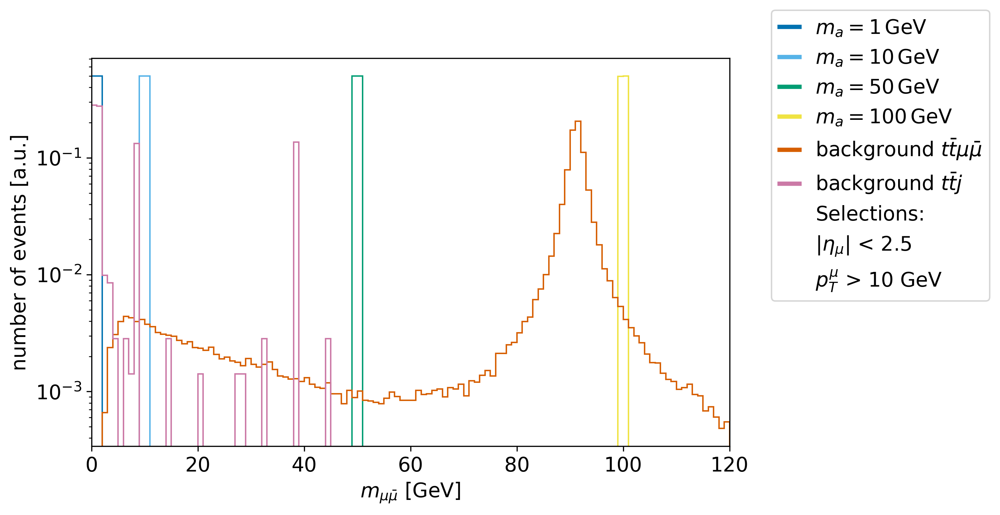

Different array lengths: 4, 2, 0, 4


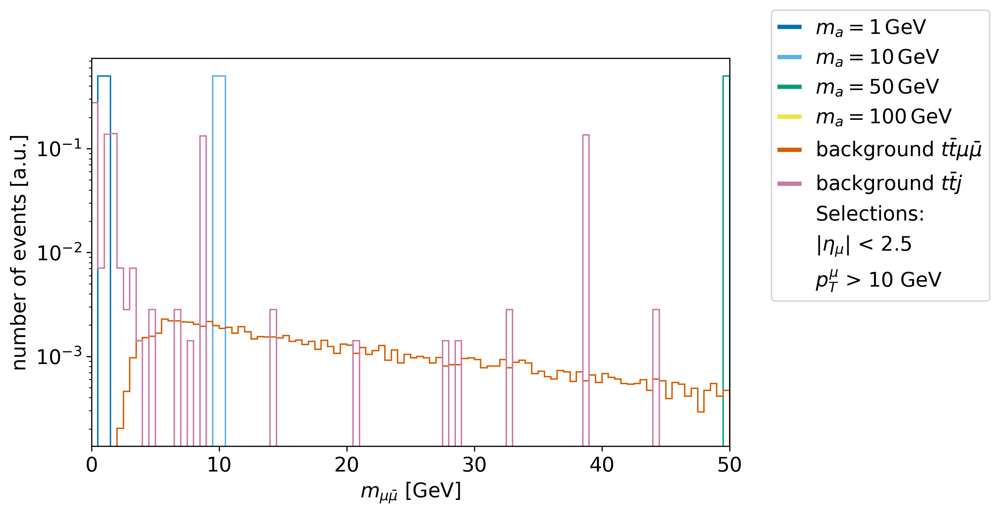

Different array lengths: 4, 1, 0, 4


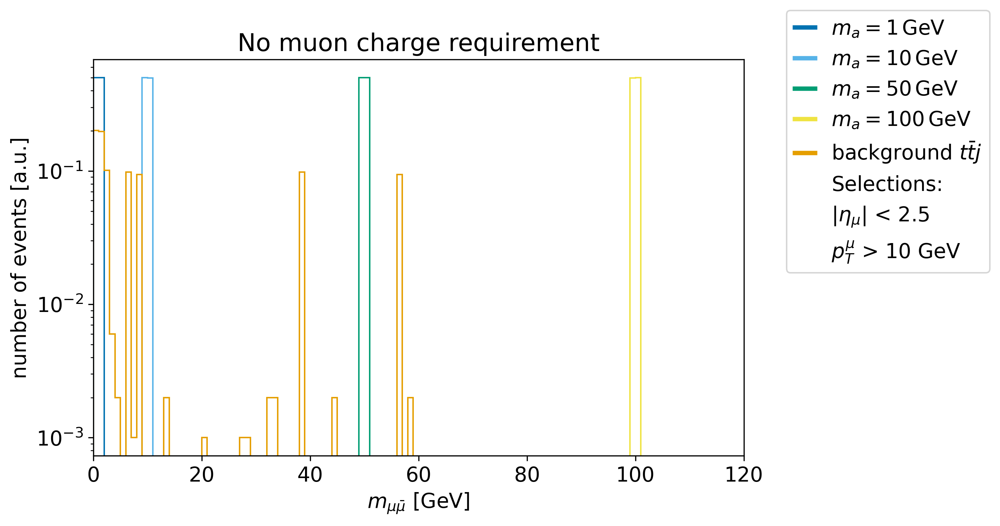

Different array lengths: 4, 2, 0, 4


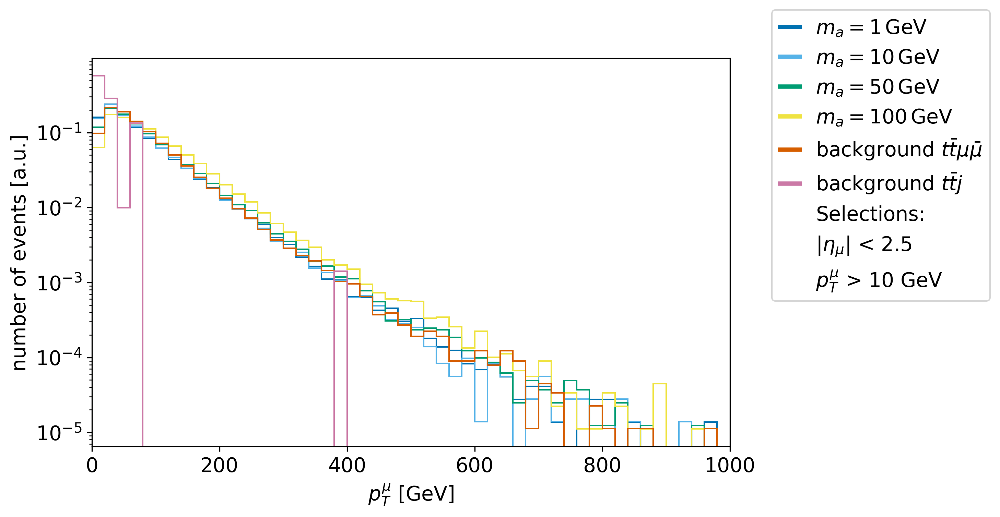

Different array lengths: 4, 2, 0, 4


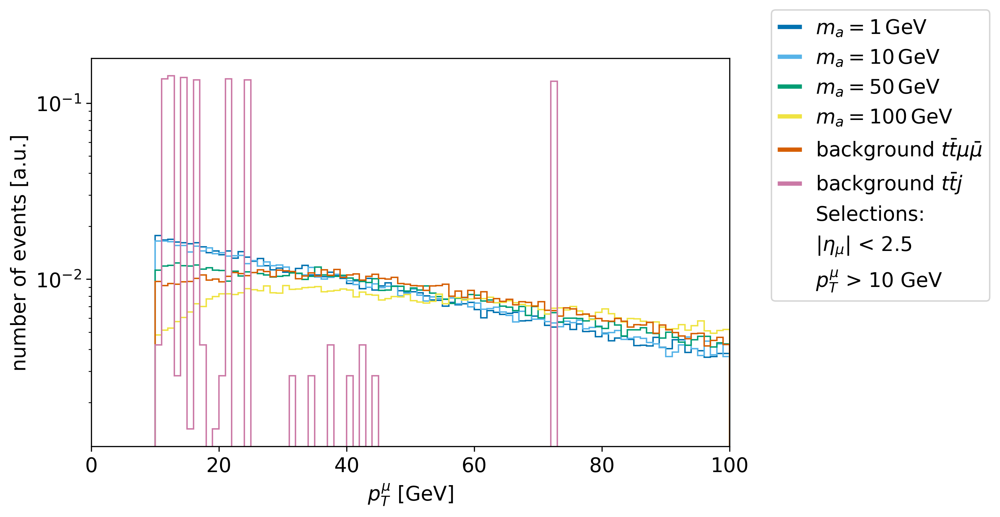

Different array lengths: 4, 1, 0, 4


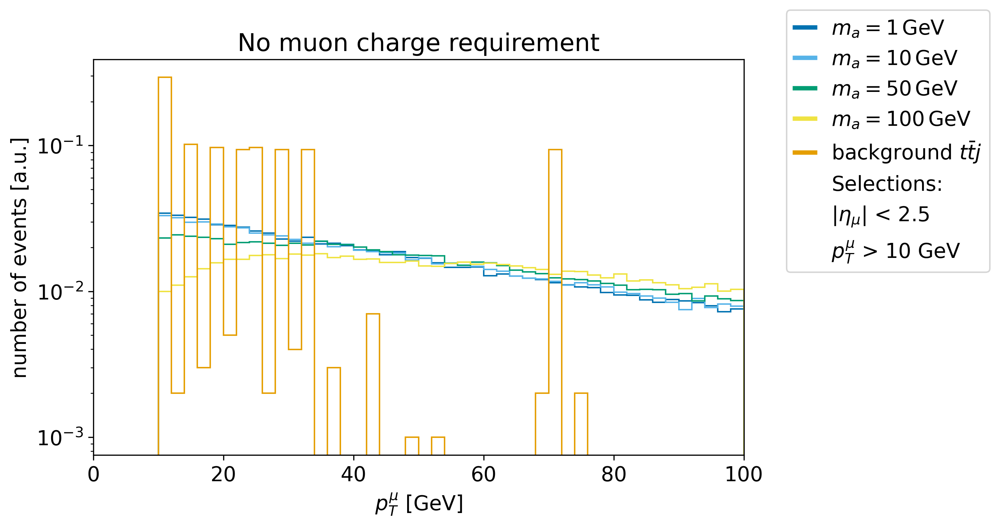

Different array lengths: 4, 2, 0, 4


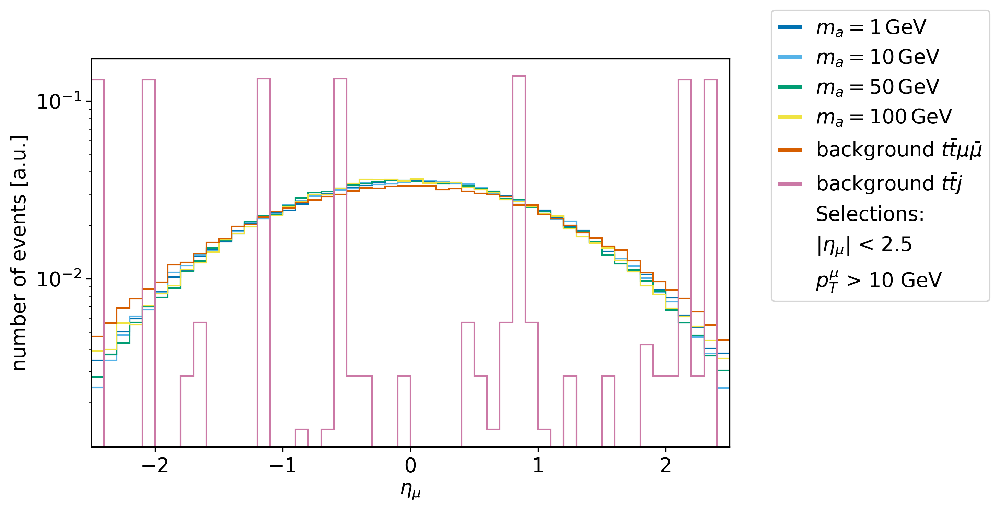

Different array lengths: 4, 1, 0, 4


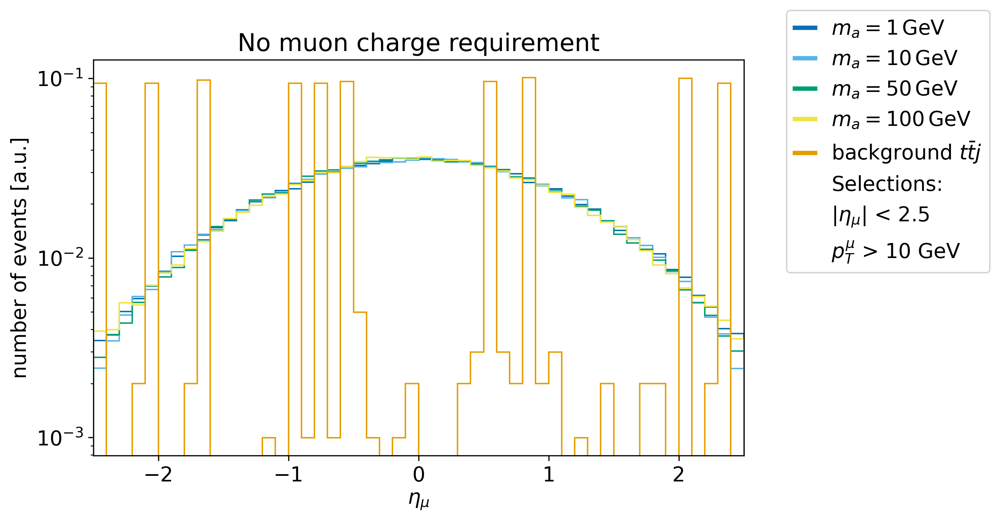

Different array lengths: 4, 2, 0, 4


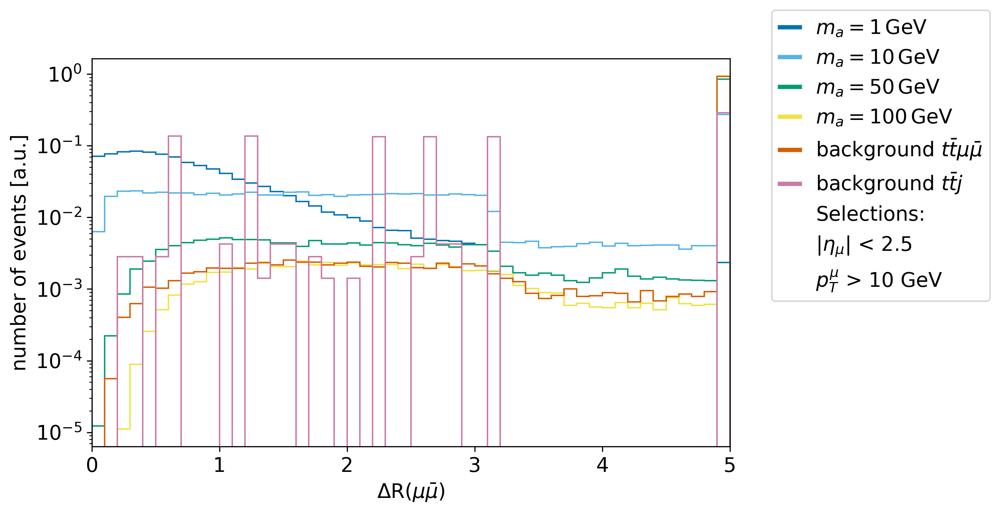

Different array lengths: 4, 1, 0, 4


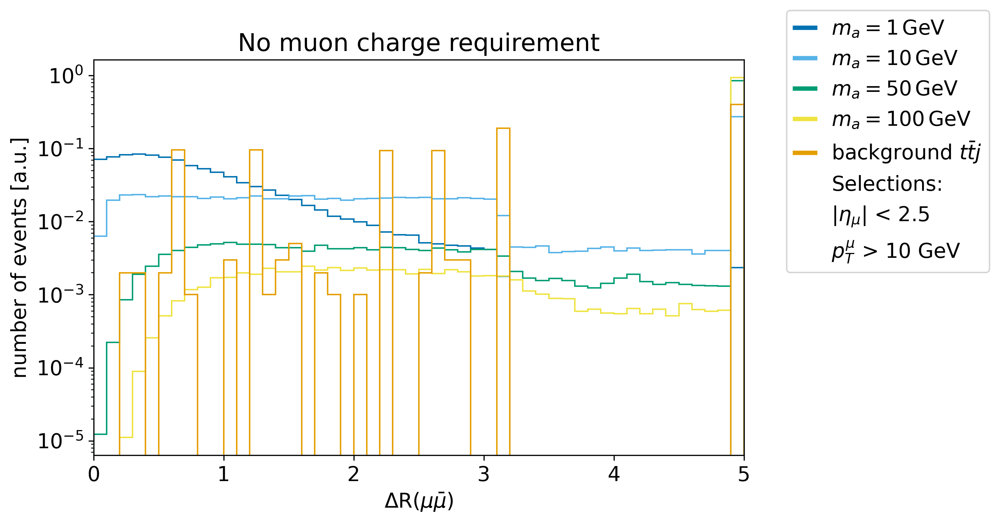

Different array lengths: 4, 2, 0, 4


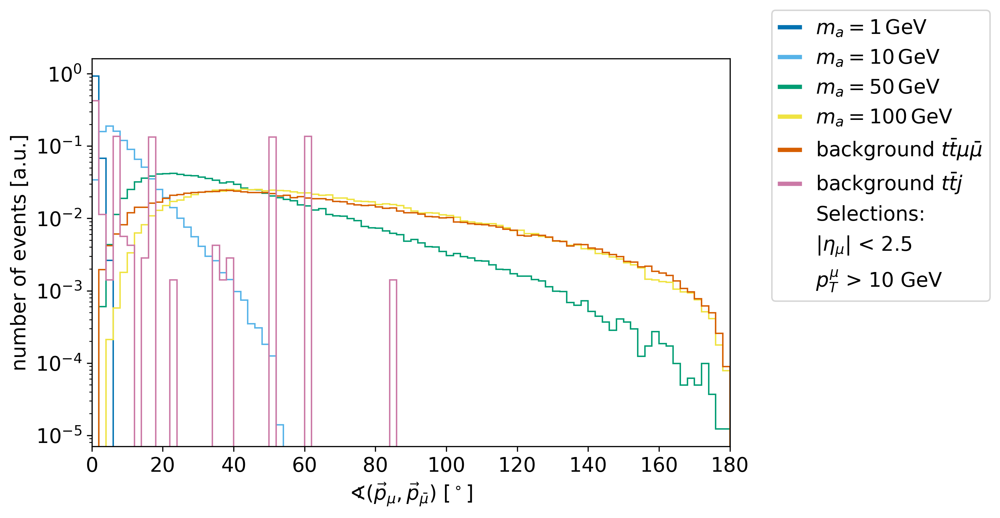

Different array lengths: 4, 1, 0, 4


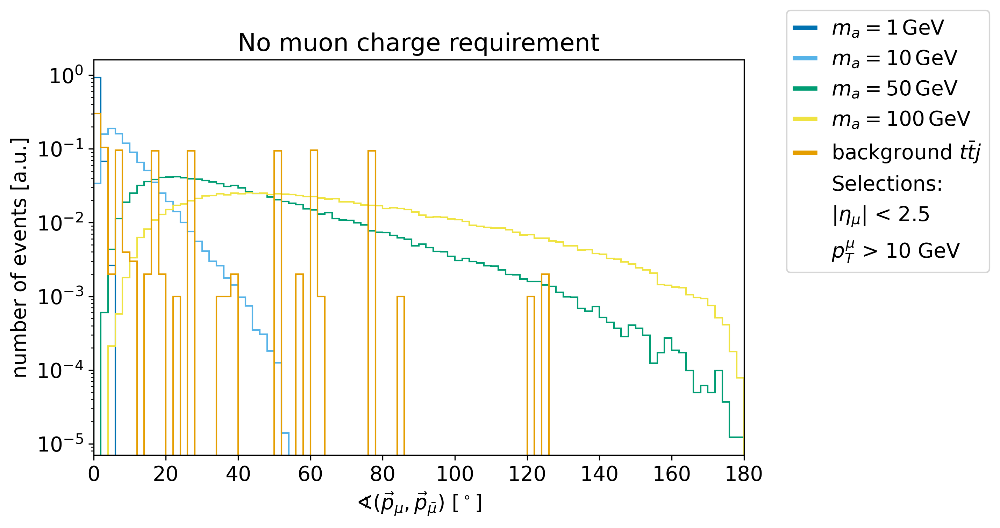

Different array lengths: 4, 2, 0, 4


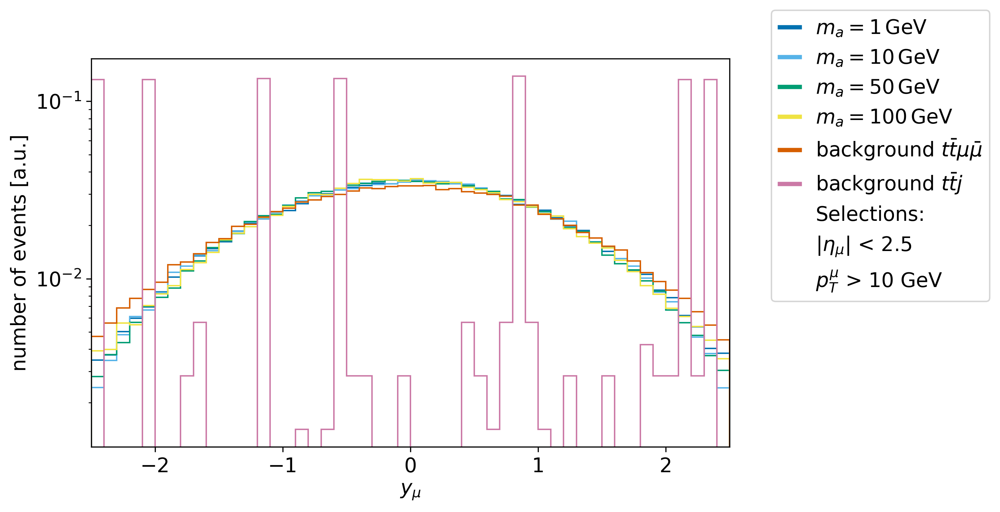

Different array lengths: 4, 1, 0, 4


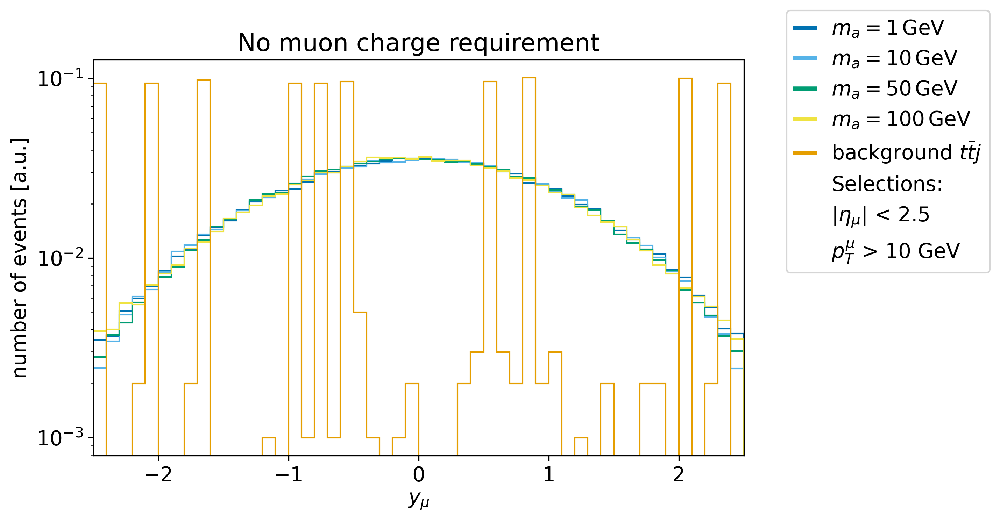

In [25]:
plot_raw_events(massLabels2, labels2, labels_ttj, selLabel)

Different array lengths: 4, 2, 0, 4


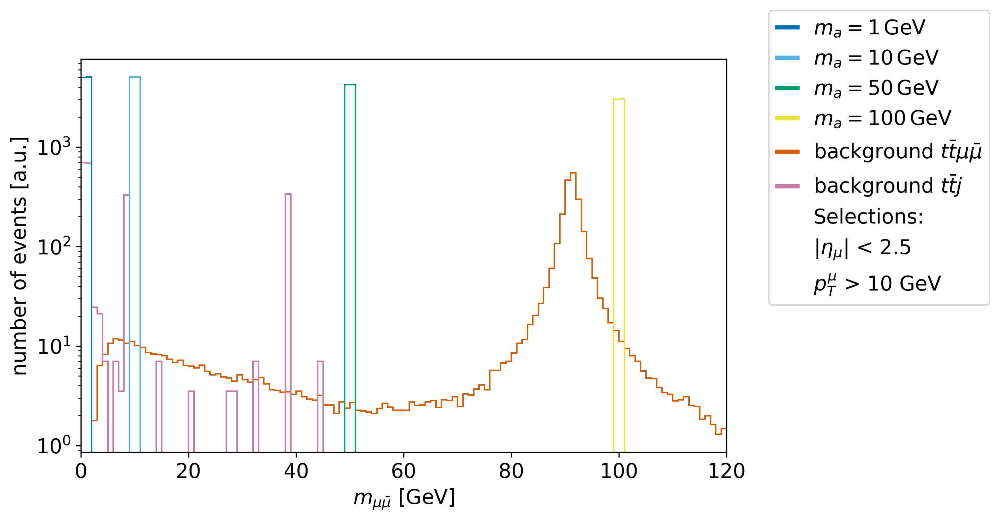

Different array lengths: 4, 2, 0, 4


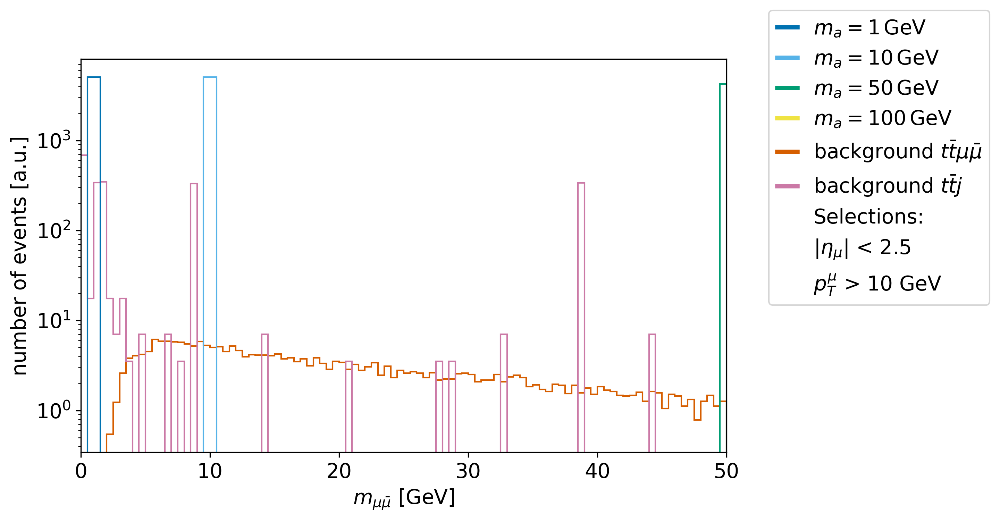

Different array lengths: 4, 1, 0, 4


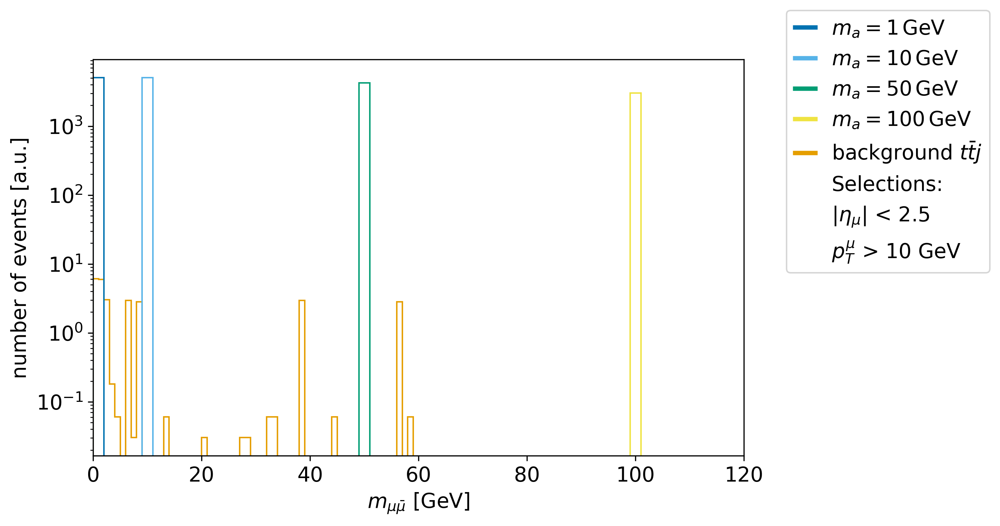

Different array lengths: 4, 2, 0, 4


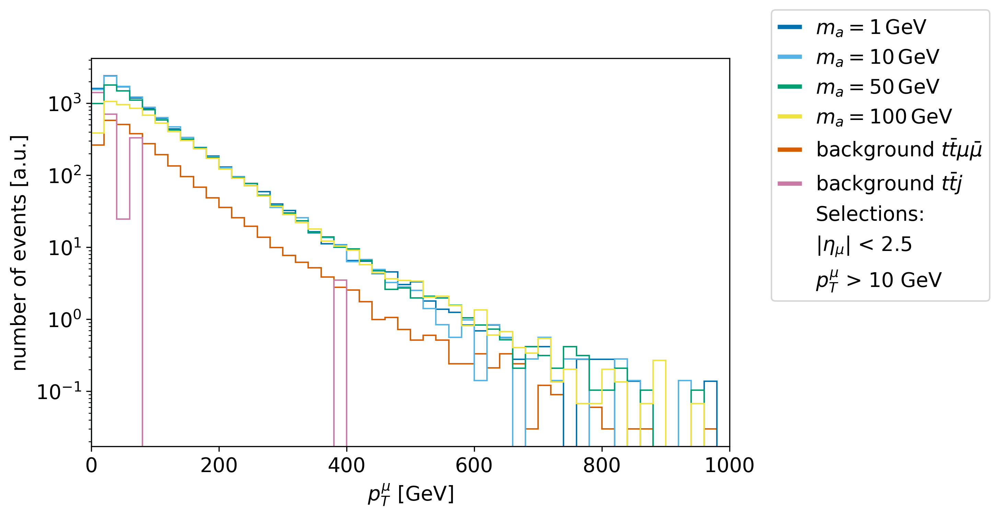

Different array lengths: 4, 2, 0, 4


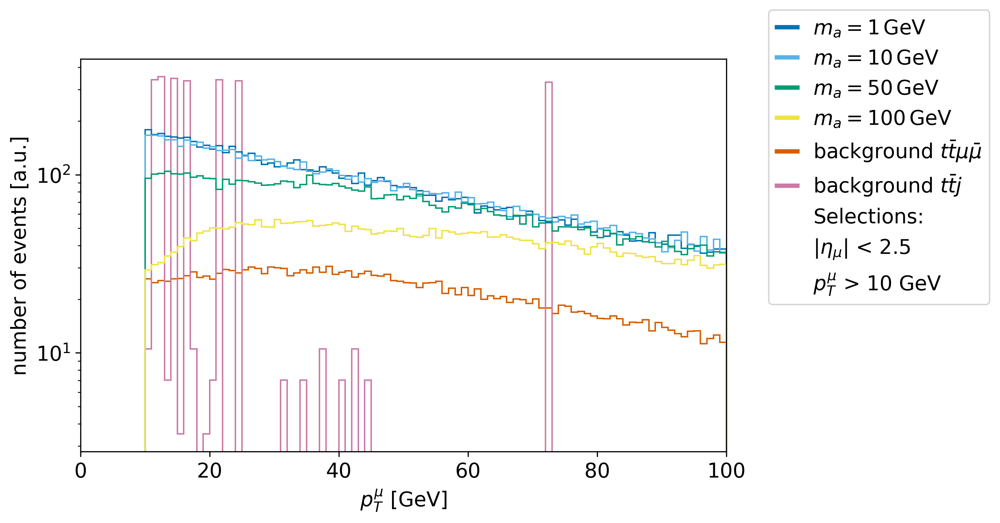

Different array lengths: 4, 1, 0, 4


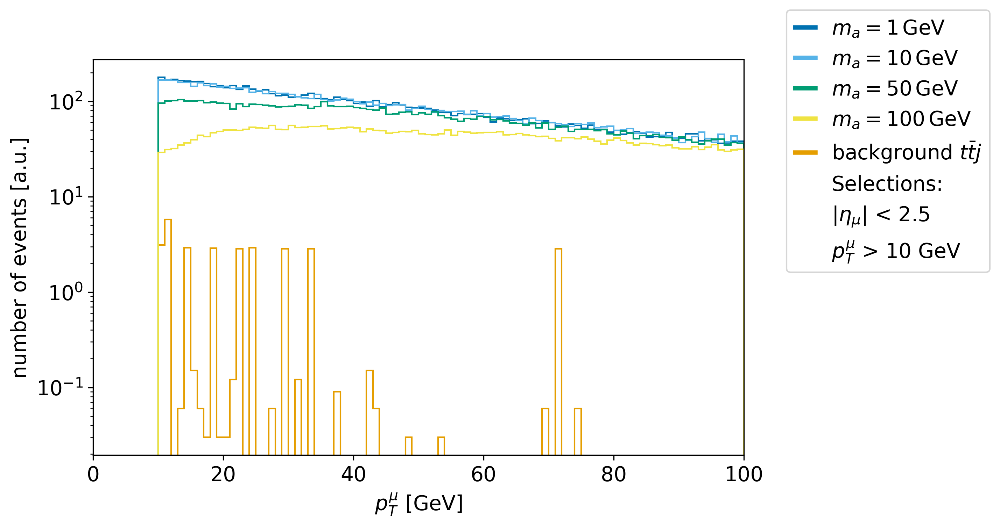

Different array lengths: 4, 2, 0, 4


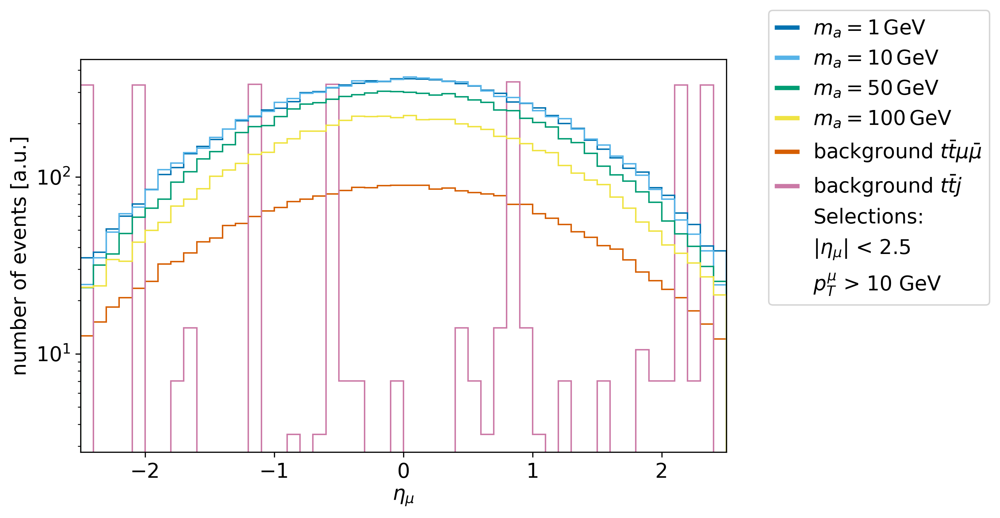

Different array lengths: 4, 1, 0, 4


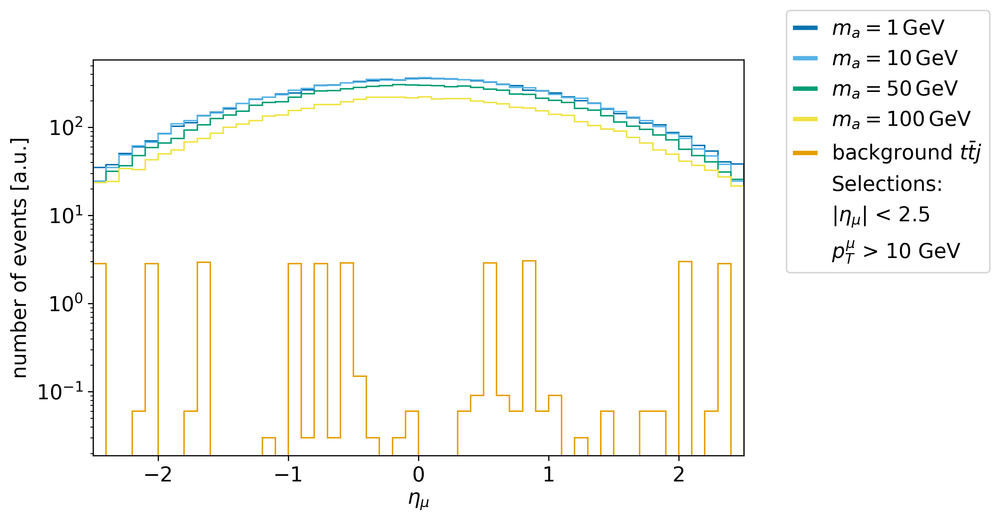

Different array lengths: 4, 2, 0, 4


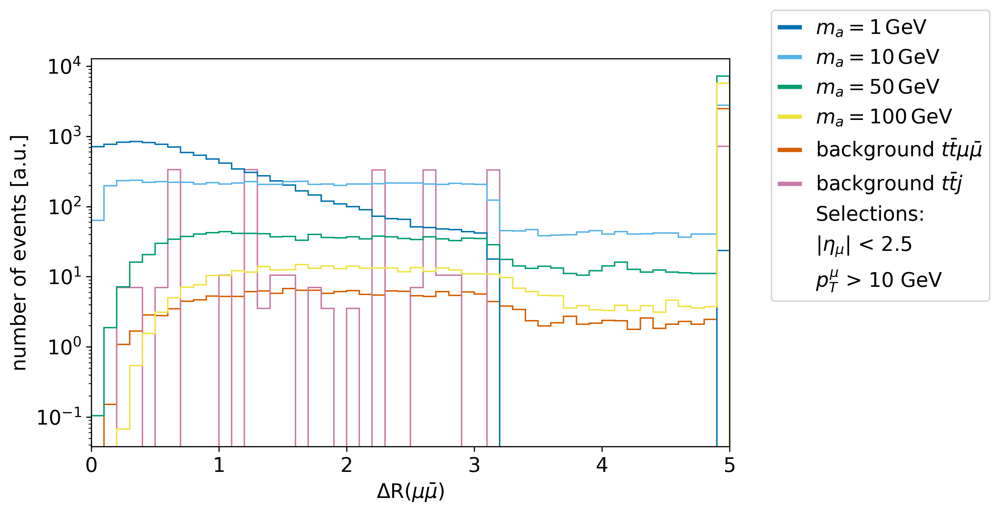

Different array lengths: 4, 1, 0, 4


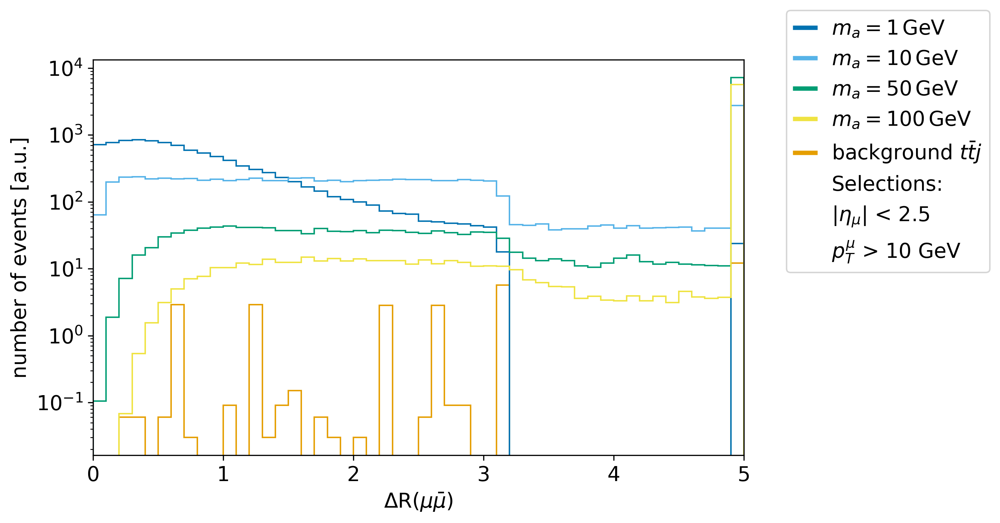

Different array lengths: 4, 2, 0, 4


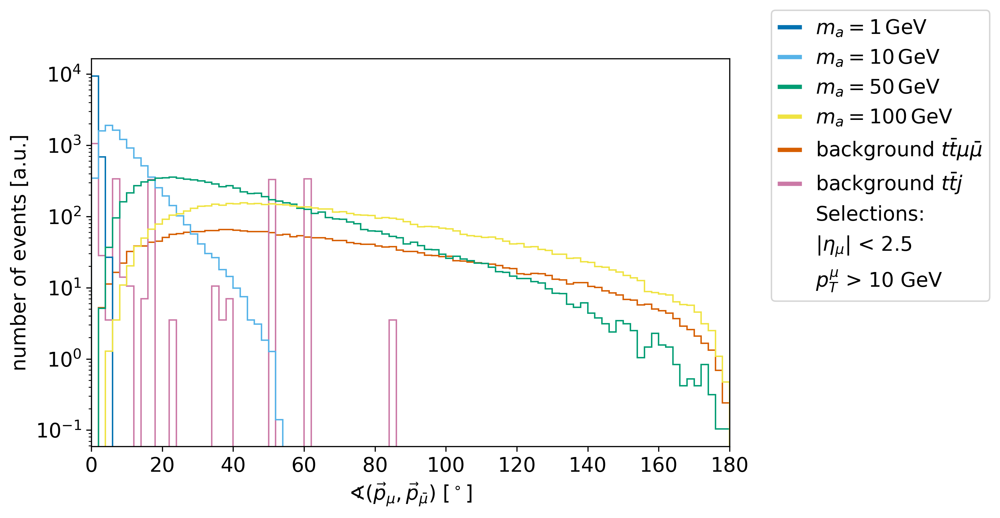

Different array lengths: 4, 1, 0, 4


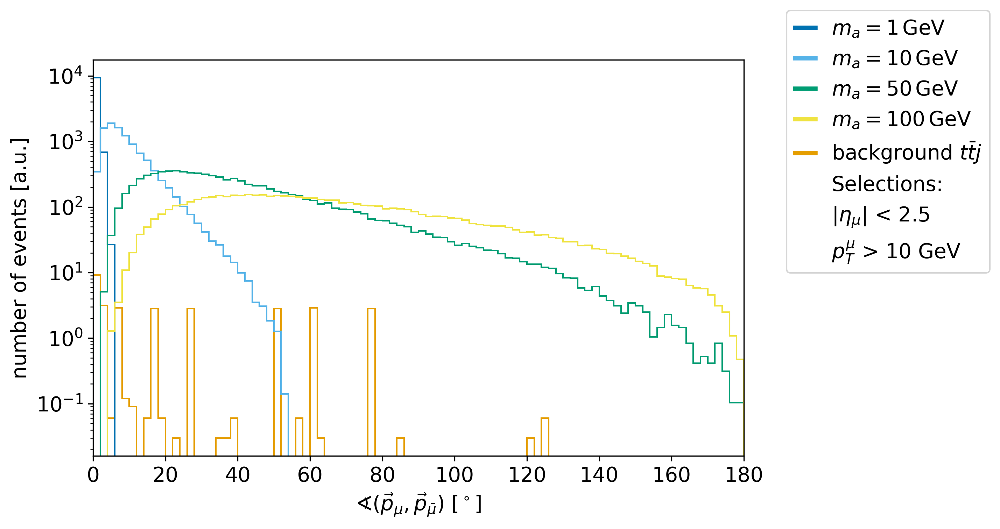

In [26]:
plot_weighted_events(cross_incl,cross_bkg,N_incl,N_bkg,intlumi,massLabels2,labels2,labels_ttj,selLabel)

### Muon DeltaR > 0.2
To accomodate requirement for ttmumu background

In [28]:
selLabel += [r"$\Delta$R($\mu\mu$) > 0.2"]
sel = ((lambda x: x>0.2),"deltaR", ["muon","antimuon"])
data_inclusive = [dc.Dataset.event_selection(ds,sel) for ds in data_inclusive]
#data_boosted = [dc.Dataset.event_selection(ds,sel) for ds in data_boosted]
data_bkg = [dc.Dataset.event_selection(ds,sel) for ds in data_bkg]
data_ttj_charge = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_charge]
print(data_inclusive)
#print(data_boosted)
print(data_bkg)
print(data_ttj_charge)

get_expected_events(data_inclusive, cross_incl, intlumi, N_incl)
get_expected_events(data_bkg, cross_bkg, intlumi, N_bkg)
get_expected_events(data_ttj_charge, cross_ttj_charge, intlumi, N_ttj_charge)
s = get_figure_of_merit(data_inclusive[0],cross_incl[0],N_incl[0],data_bkg,cross_bkg,N_bkg,intlumi)
print("Figure of merit:   ", s)

[This Dataset contains 62028 events., This Dataset contains 69998 events., This Dataset contains 81119 events., This Dataset contains 89656 events.]
[This Dataset contains 89132 events., This Dataset contains 707 events.]
[This Dataset contains 1001 events.]
Expected number of events:  8587.9347714  +-  34.48219059650934
Expected number of events:  9846.971449919998  +-  37.21858544593485
Expected number of events:  8458.817976945003  +-  29.69944854521195
Expected number of events:  6064.216407899999  +-  20.252797094518343
Expected number of events:  2685.5569645200003  +-  8.995339168272295
Expected number of events:  2480.760827895  +-  93.2986132690755
Expected number of events:  3512.364340485  +-  111.01521914327421
Figure of merit:    72.9785892088958


Different array lengths: 4, 2, 0, 4


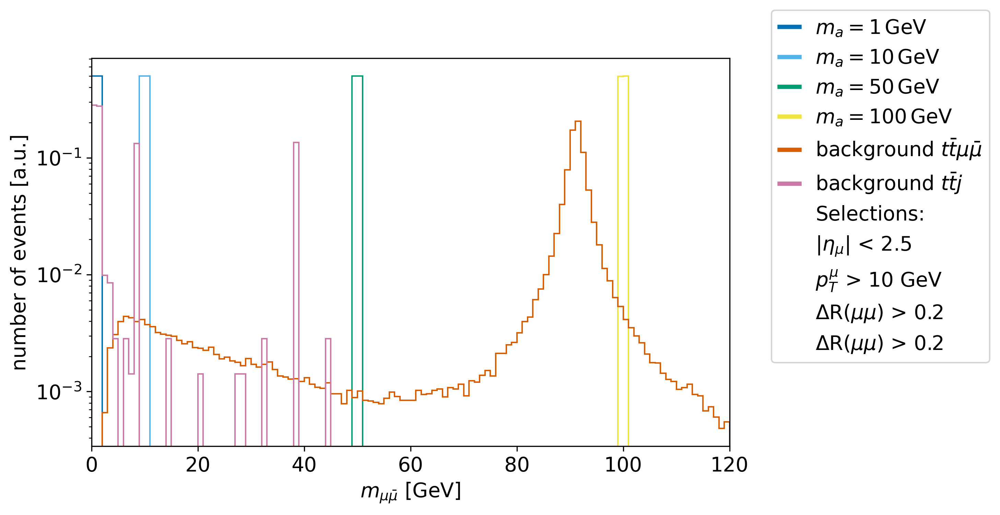

Different array lengths: 4, 2, 0, 4


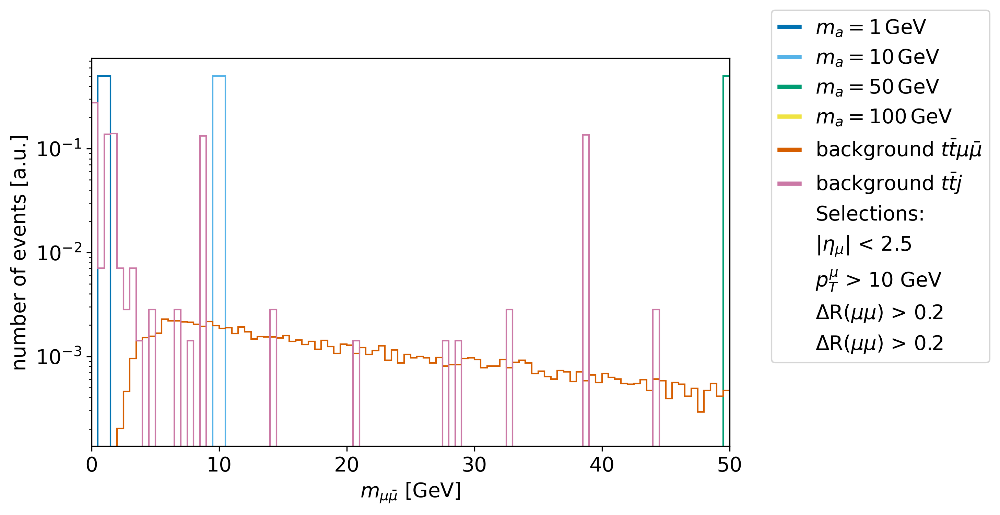

Different array lengths: 4, 1, 0, 4


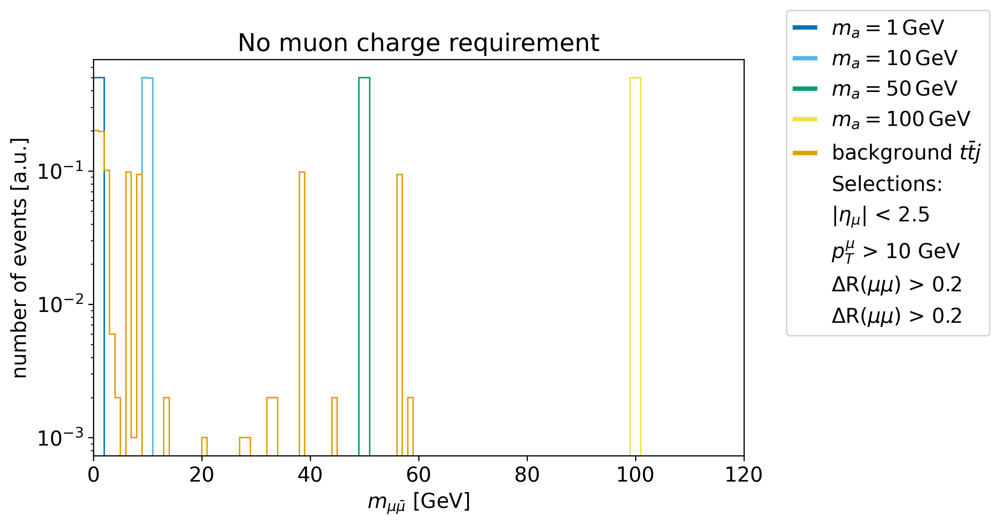

Different array lengths: 4, 2, 0, 4


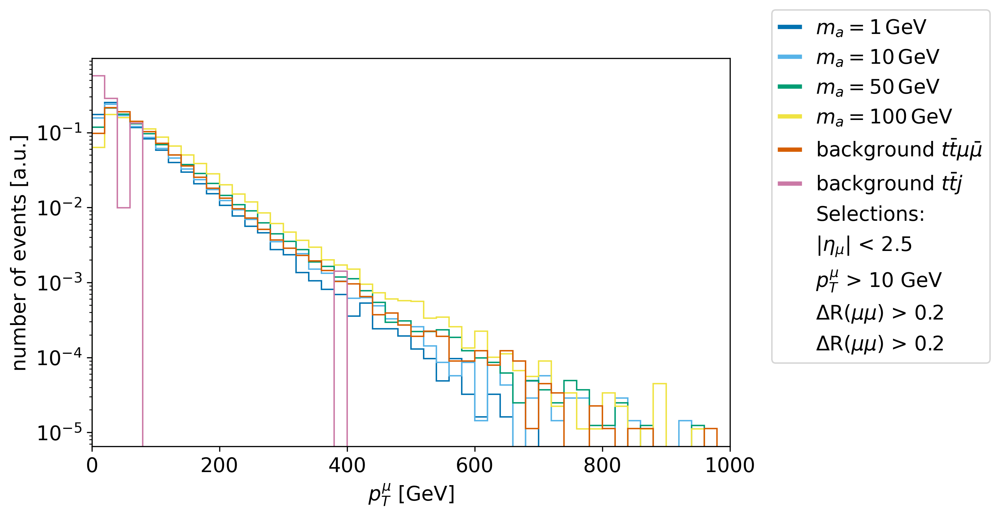

Different array lengths: 4, 2, 0, 4


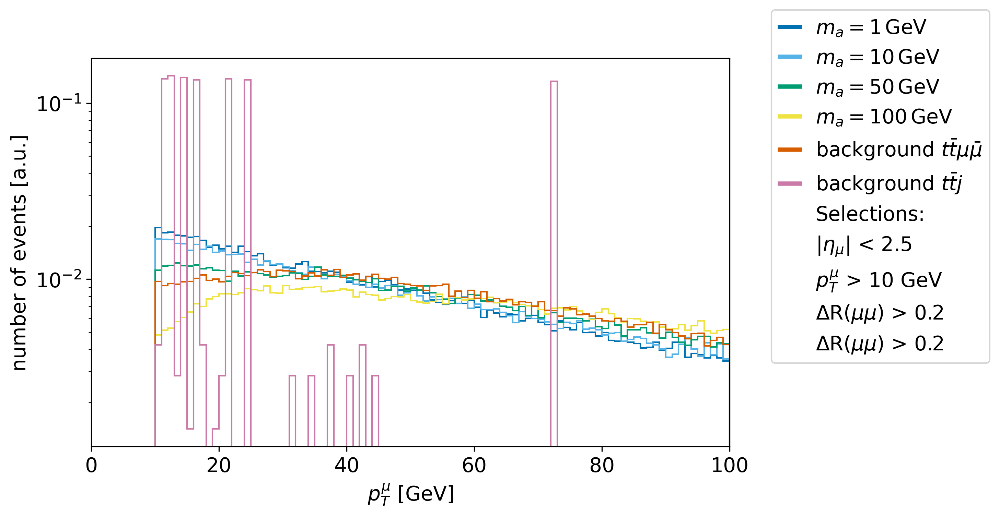

Different array lengths: 4, 1, 0, 4


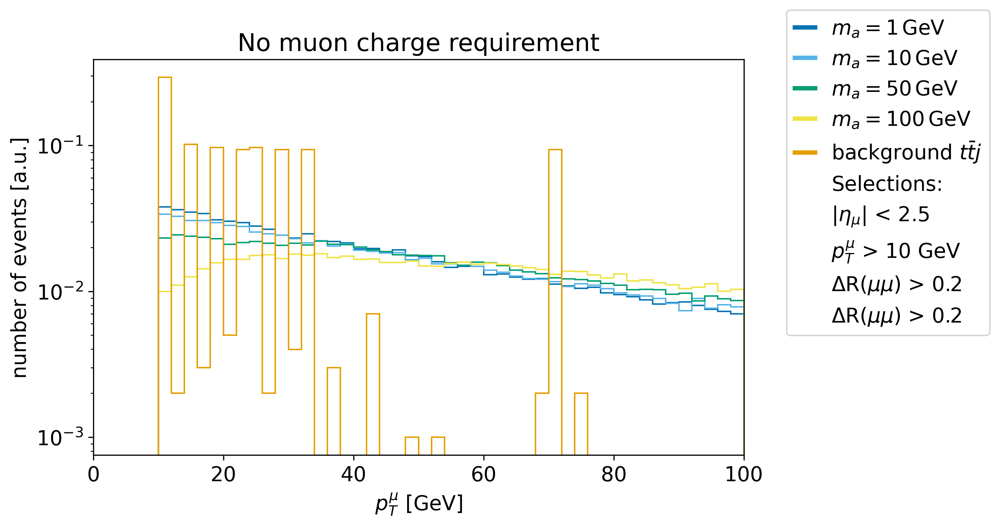

Different array lengths: 4, 2, 0, 4


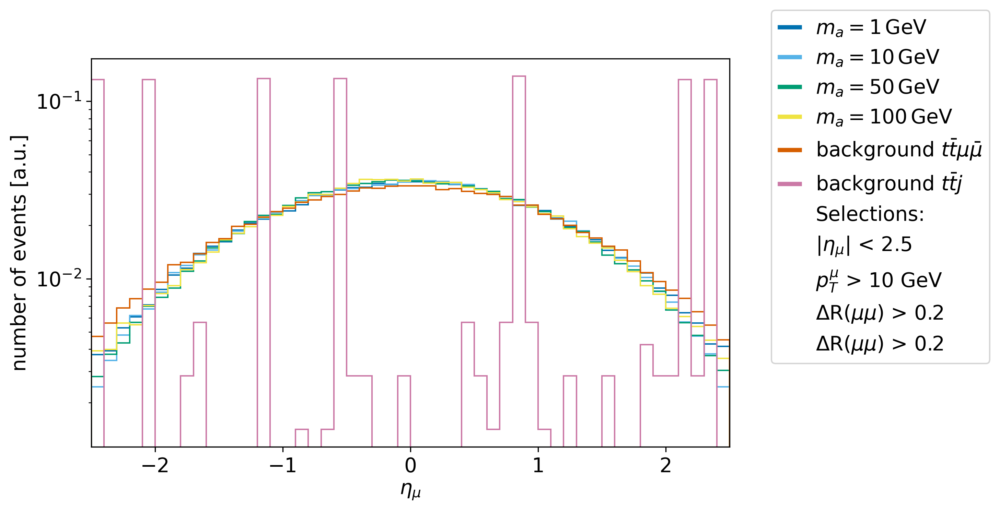

Different array lengths: 4, 1, 0, 4


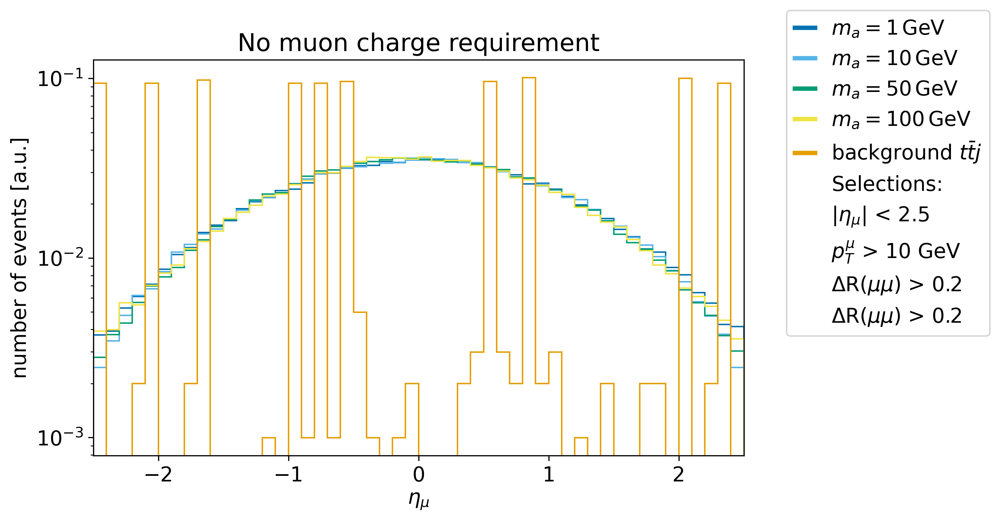

Different array lengths: 4, 2, 0, 4


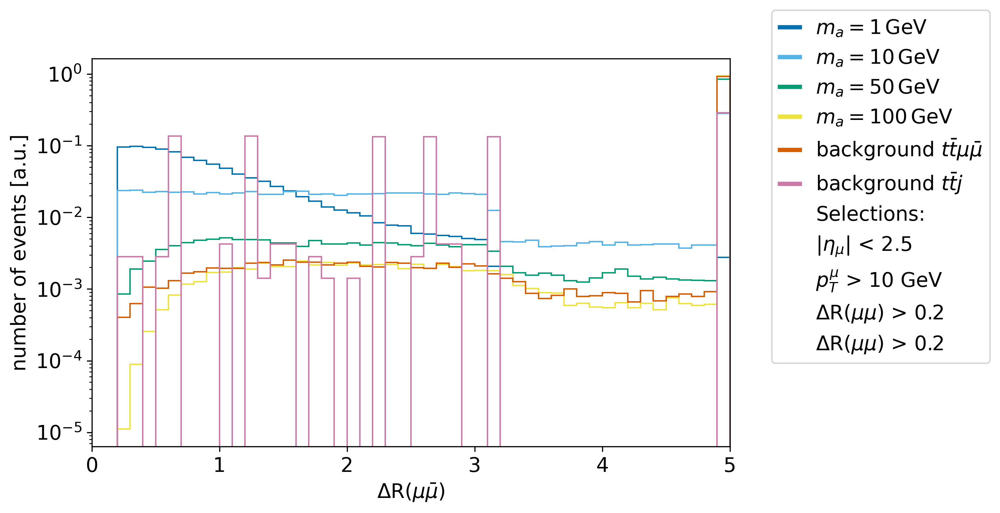

Different array lengths: 4, 1, 0, 4


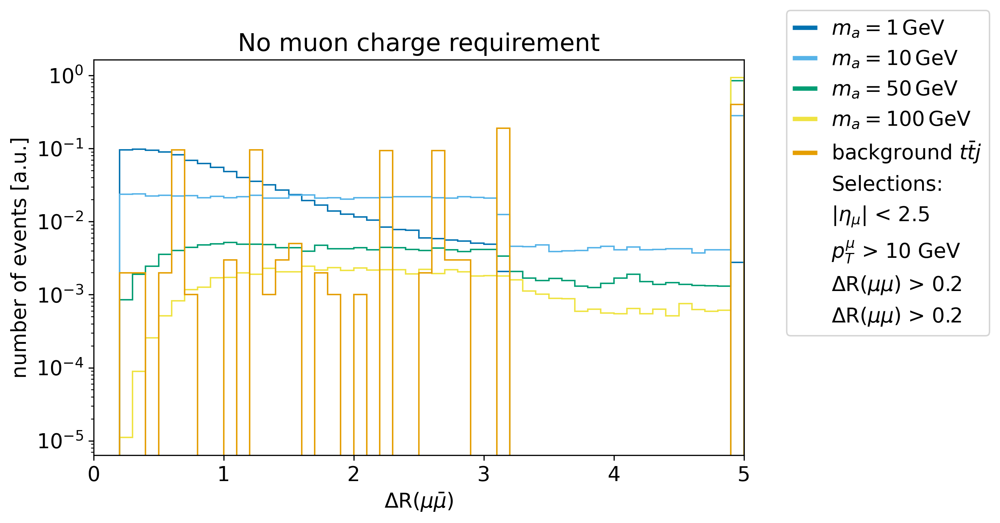

Different array lengths: 4, 2, 0, 4


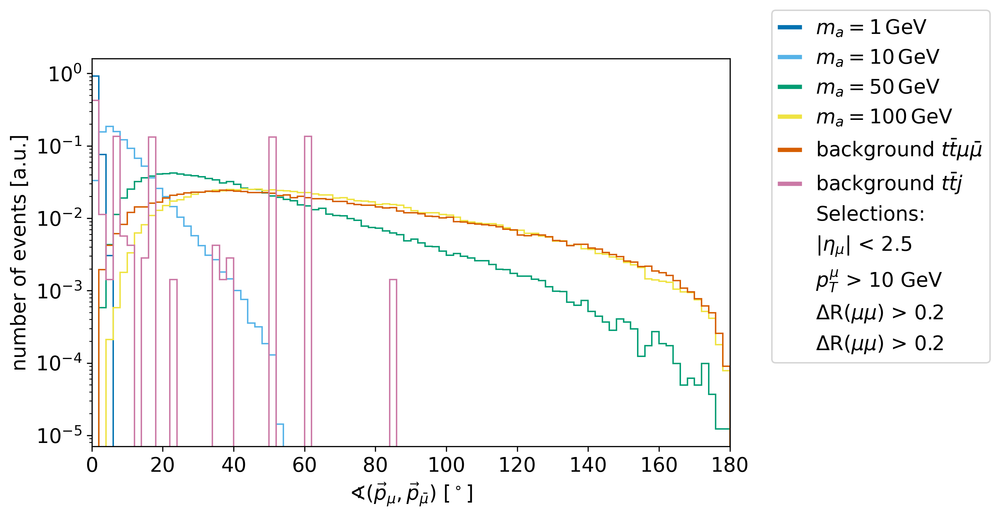

Different array lengths: 4, 1, 0, 4


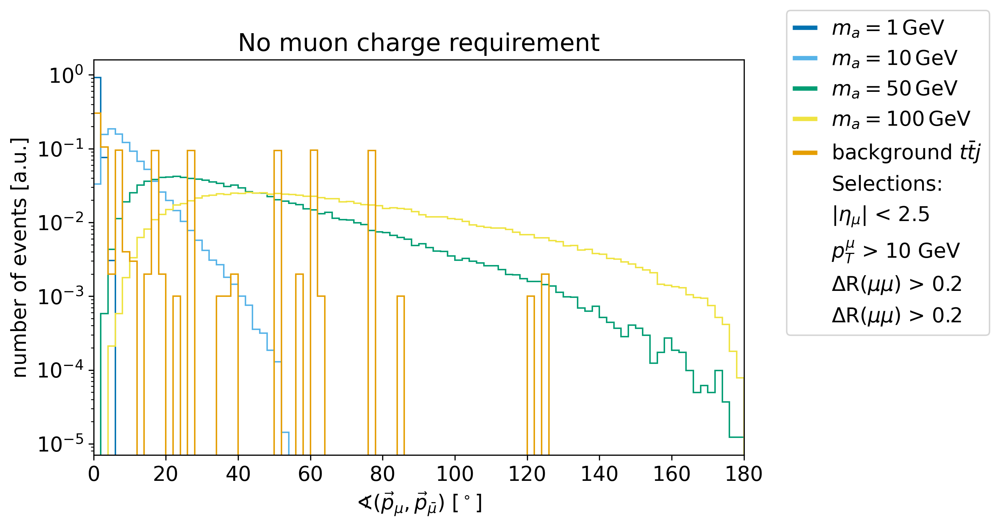

Different array lengths: 4, 2, 0, 4


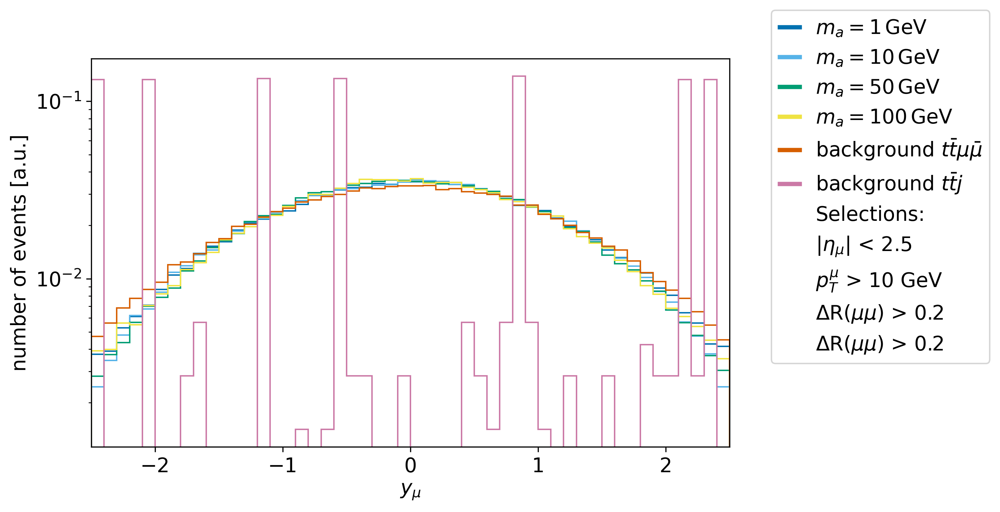

Different array lengths: 4, 1, 0, 4


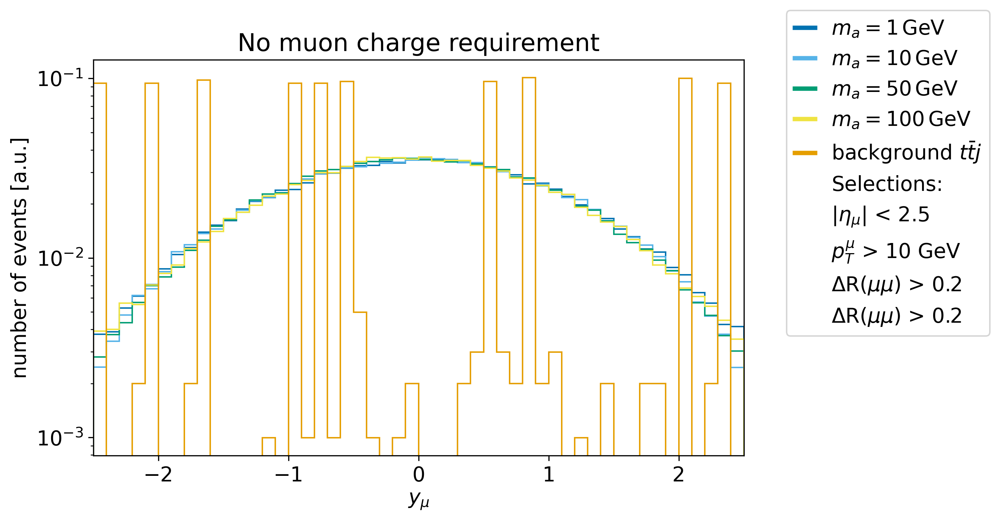

In [29]:
plot_raw_events(massLabels2, labels2, labels_ttj, selLabel)

Different array lengths: 4, 2, 0, 4


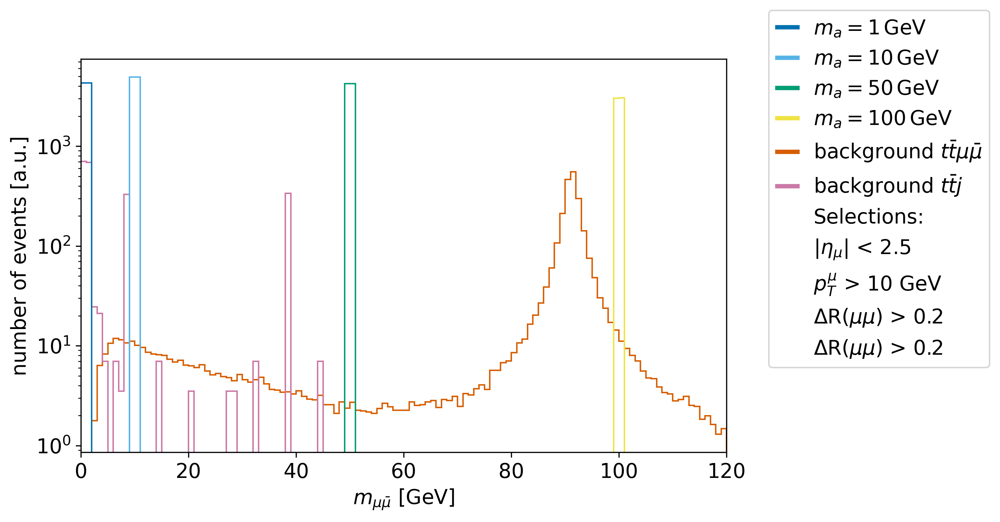

Different array lengths: 4, 2, 0, 4


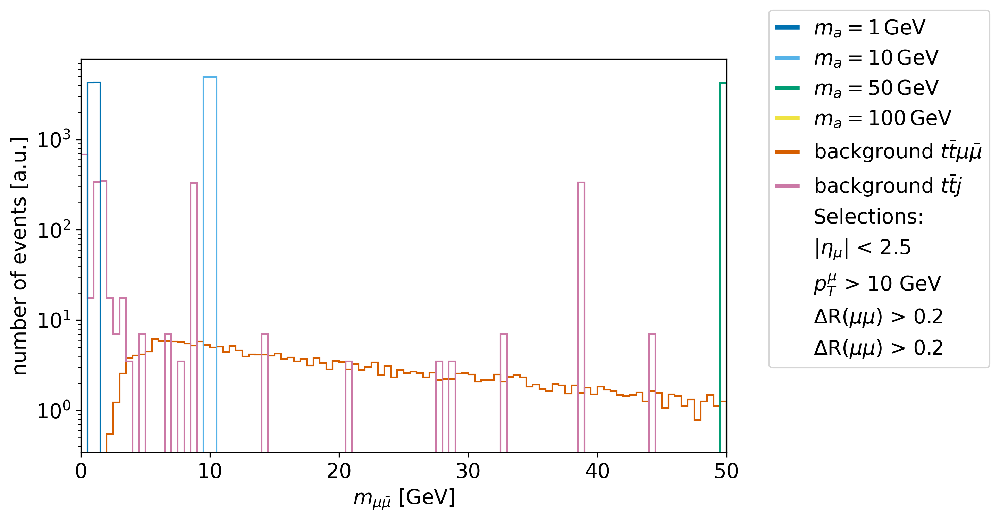

Different array lengths: 4, 1, 0, 4


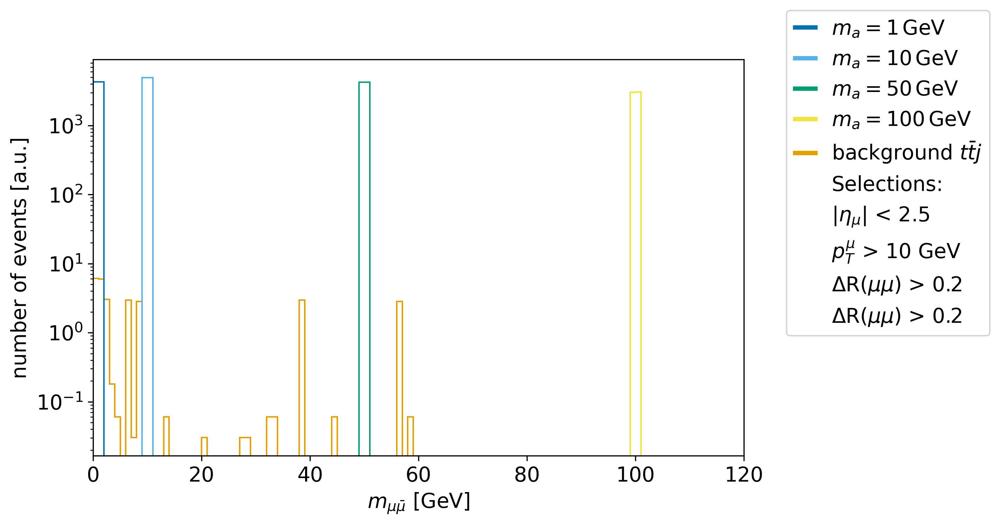

Different array lengths: 4, 2, 0, 4


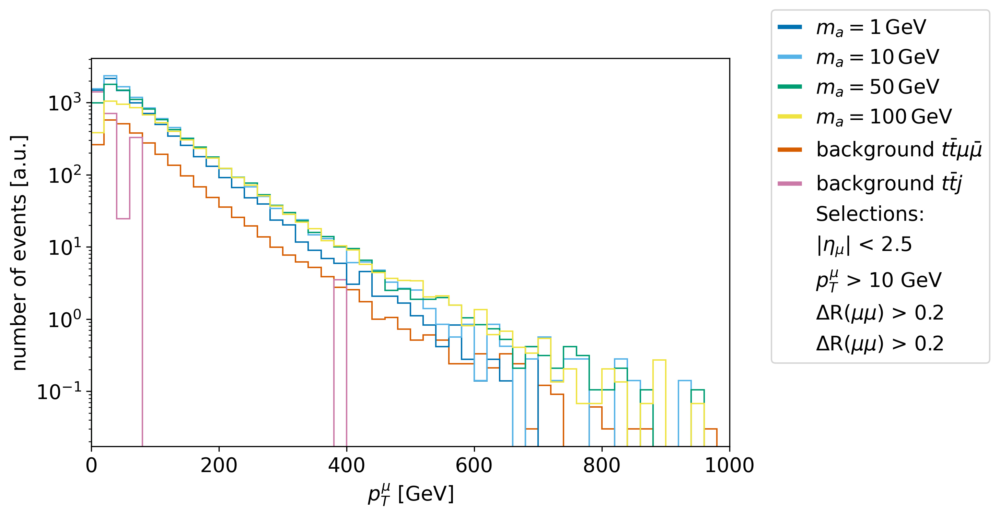

Different array lengths: 4, 2, 0, 4


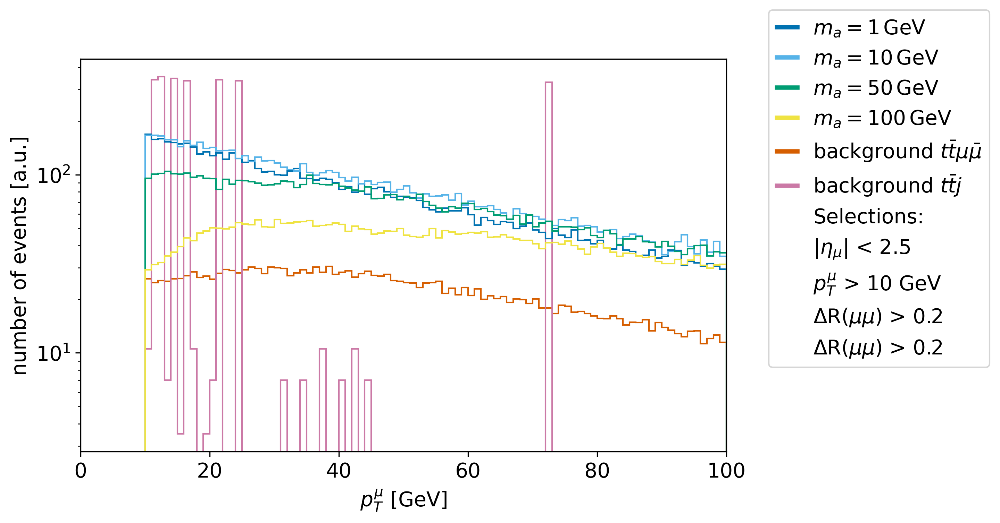

Different array lengths: 4, 1, 0, 4


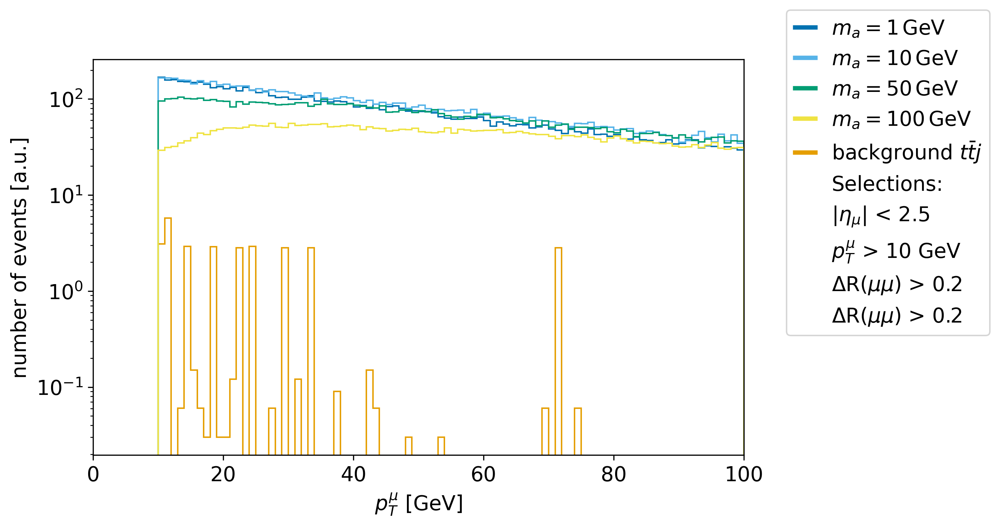

Different array lengths: 4, 2, 0, 4


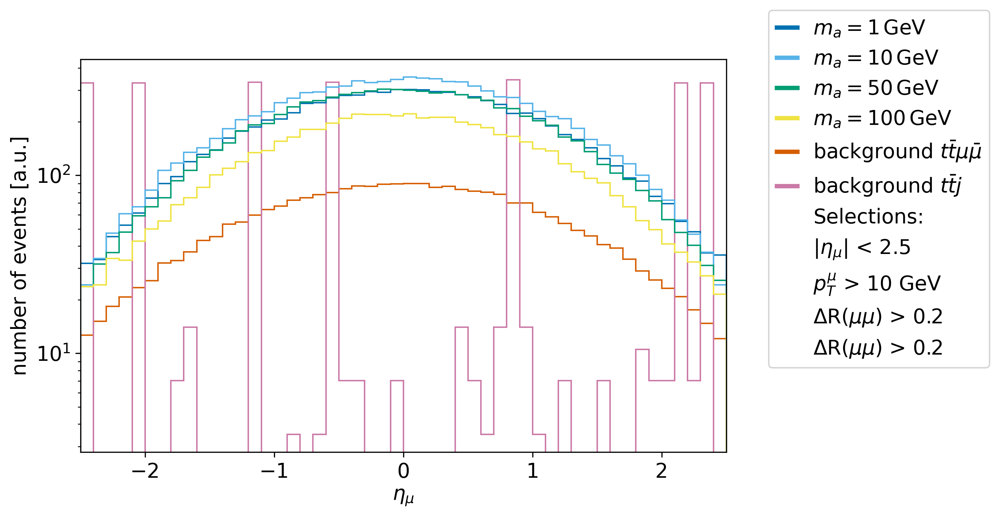

Different array lengths: 4, 1, 0, 4


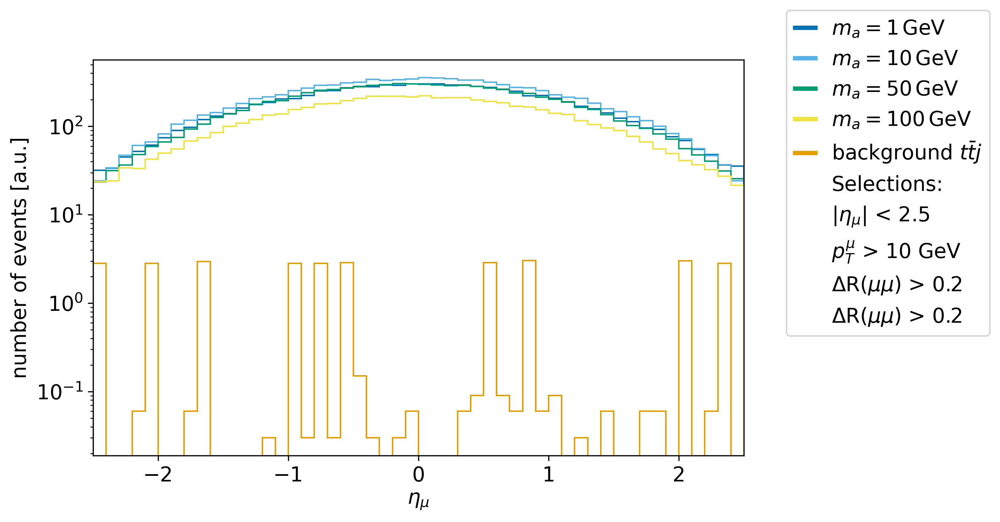

Different array lengths: 4, 2, 0, 4


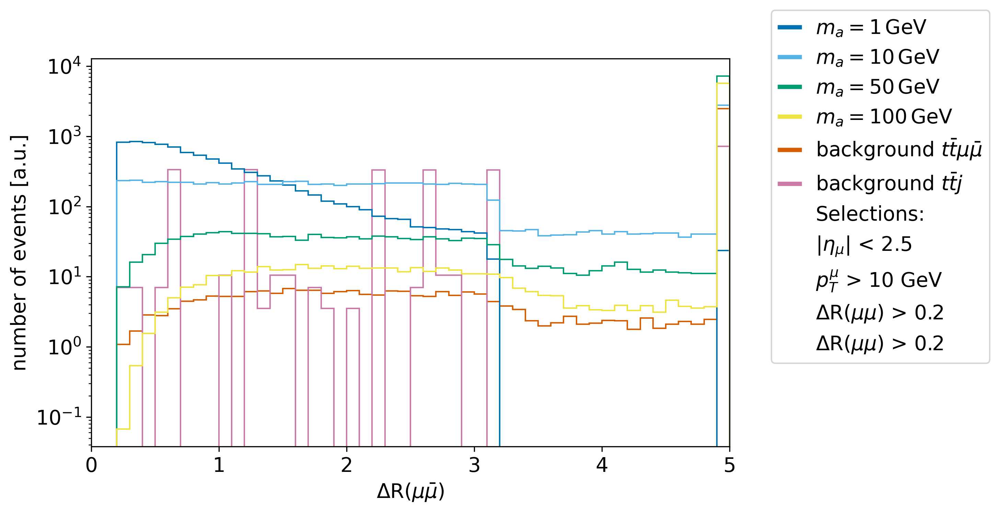

Different array lengths: 4, 1, 0, 4


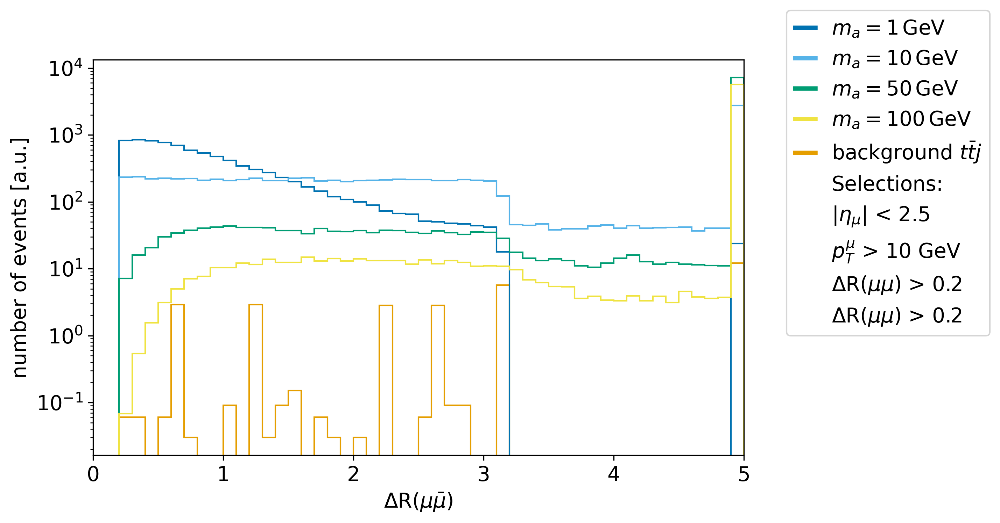

Different array lengths: 4, 2, 0, 4


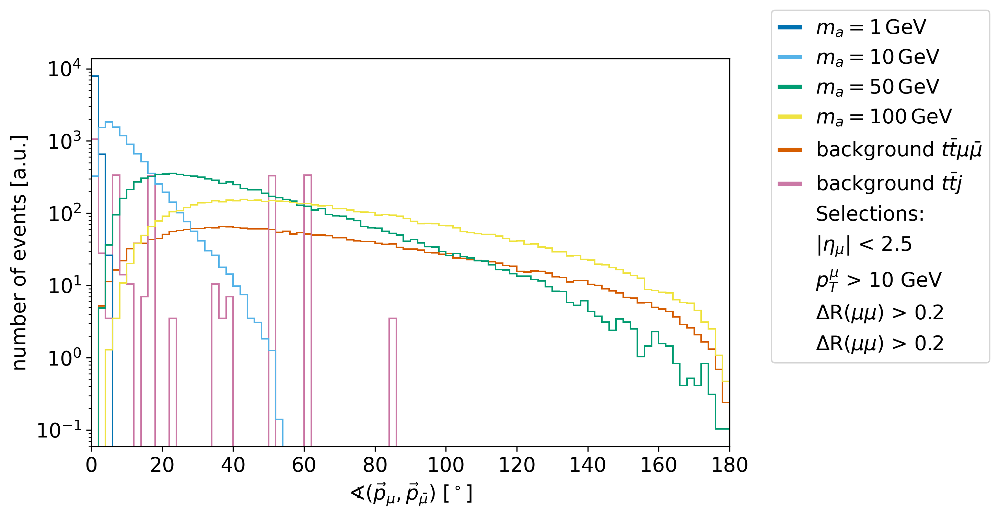

Different array lengths: 4, 1, 0, 4


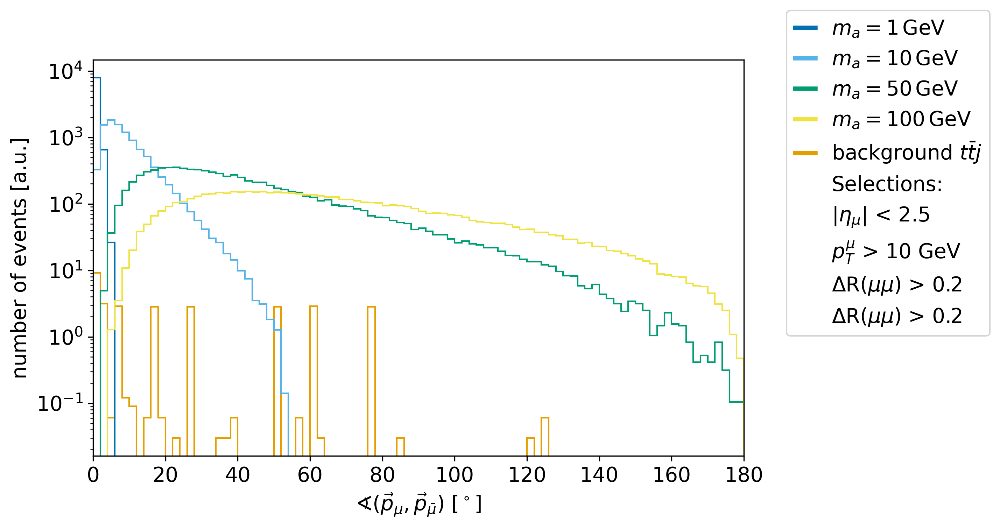

In [30]:
plot_weighted_events(cross_incl,cross_bkg,N_incl,N_bkg,intlumi,massLabels2,labels2,labels_ttj,selLabel)

# Testing new ttmumu samples

In [ ]:
data_ttmumu_input = [dc.Dataset.from_lhe_alp("/eos/user/l/lrygaard/ttalp/ttmumu/Events/run_01/unweighted_events.lhe")]
data_ttmumu2_input = [dc.Dataset.from_lhe_alp("/eos/user/l/lrygaard/ttalp/ttmumu_new/Events/run_01/unweighted_events.lhe")]

In [ ]:
data_ttmumu_nocut = data_ttmumu_input.copy()
data_ttmumu2_nocut = data_ttmumu2_input.copy()
sel = ((lambda x: abs(x)<2.5),"eta", ["muon"])
data_ttmumu =[dc.Dataset.event_selection(ds,sel) for ds in data_ttmumu_nocut]
data_ttmumu2 =[dc.Dataset.event_selection(ds,sel) for ds in data_ttmumu2_nocut]
sel = ((lambda x: abs(x)<2.5),"eta", ["antimuon"])
data_ttmumu = [dc.Dataset.event_selection(ds,sel) for ds in data_ttmumu]
data_ttmumu2 = [dc.Dataset.event_selection(ds,sel) for ds in data_ttmumu2]
print(data_ttmumu)
print(data_ttmumu2)

data_ttmumu_org = data_ttmumu.copy()
data_ttmumu2_org = data_ttmumu2.copy()
data_bkg = []
data_bkg.append(data_bkg_org[2]) # ttmumu Bkg_3
data_bkg.append(data_bkg_org[4]) # ttj

ttmumuLabel = [r'background $t\bar{t}\mu\bar{\mu}$ 2', r'background $t\bar{t}\mu\bar{\mu}$ 3']

Different array lengths: 2, 1, 1, 2


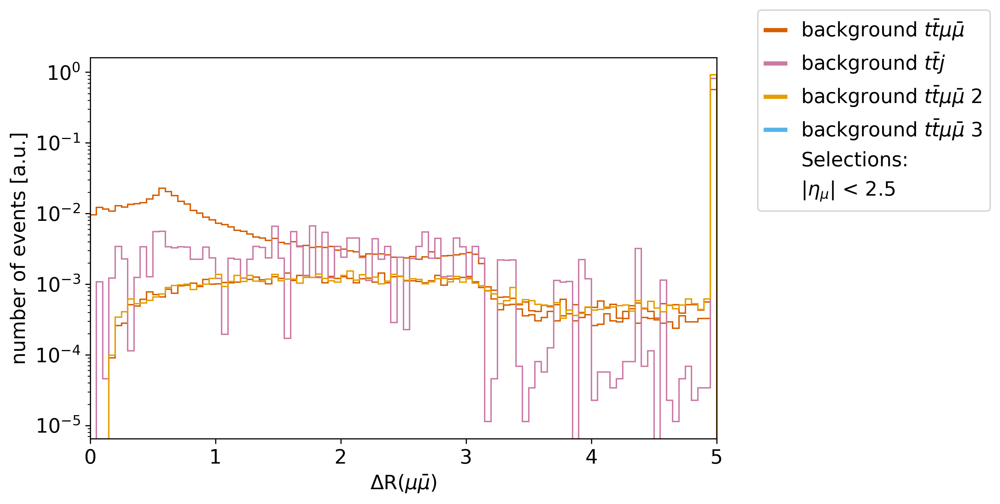

Different array lengths: 2, 1, 1, 2


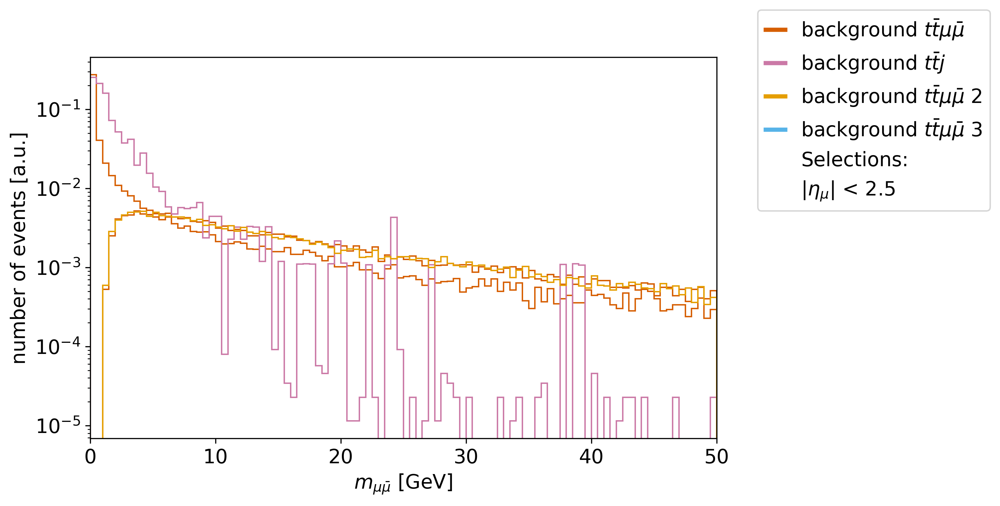

Different array lengths: 2, 1, 1, 2


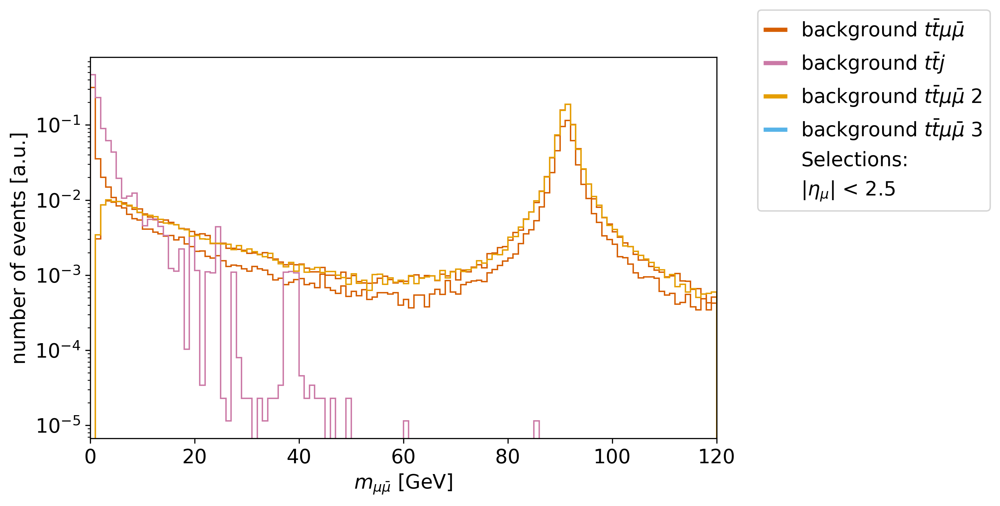

In [25]:
mypl.hist1dcomp2(data("deltaR",["antimuon","muon"],"bkg"),data("deltaR",["antimuon","muon"],"ttmumu"),data("deltaR",["antimuon","muon"],"ttmumu2"),labels2,dirLabel["deltaR_muons"],customXlabels=ttmumuLabel,nbins=100,customXlim=[0,5],log_scale=True,selLabel=selLabel,clip=True)
mypl.hist1dcomp2(data("inv_mass",["antimuon","muon"],"bkg"),data("inv_mass",["antimuon","muon"],"ttmumu"),data("inv_mass",["antimuon","muon"],"ttmumu2"),labels2,dirLabel["mmumu"],customXlabels=ttmumuLabel,nbins=100,customXlim=[0,50],log_scale=True,selLabel=selLabel)
mypl.hist1dcomp2(data("inv_mass",["antimuon","muon"],"bkg"),data("inv_mass",["antimuon","muon"],"ttmumu"),data("inv_mass",["antimuon","muon"],"ttmumu2"),labels2,dirLabel["mmumu"],customXlabels=ttmumuLabel,nbins=120,customXlim=[0,120],log_scale=True,selLabel=selLabel)


# Changing the mass region of signal

In [41]:
data_inclusive = []
data_inclusive.append(data_inclusive_org[0]) # 50 MeV
data_inclusive.append(data_inclusive_org[2]) # 1 GeV
data_inclusive.append(data_inclusive_org[5]) # 10 GeV
#data_inclusive.append(data_inclusive_org[7]) # 30 GeV
data_inclusive.append(data_inclusive_org[8]) # 50 GeV

data_bkg = []
data_bkg.append(data_bkg_org[2])
data_bkg.append(data_bkg_org[4])

cross_incl = []
cross_incl.append(cross_incl_org[0])
cross_incl.append(cross_incl_org[2])
cross_incl.append(cross_incl_org[5])
#cross_incl.append(cross_incl_org[7])
cross_incl.append(cross_incl_org[8])

N_incl = [100000,100000,100000,100000]
N_bkg = [100000,100*100000]

print(data_inclusive)
print(data_bkg)
get_expected_events(data_inclusive, cross_incl, intlumi, N_incl)
get_expected_events(data_bkg, cross_bkg, intlumi, N_bkg)

massLabels2 = [r"$m_a=50\,$MeV",r"$m_a=1\,$GeV",r"$m_a=10\,$GeV",r"$m_a=50\,$GeV"]
masses2 = [0.05,1,10,50]
labels2 = [r'background $t\bar{t}\mu\bar{\mu}$', r'background $t\bar{t}j$']
labels_ttj = [r'background $t\bar{t}j$']
title_charge = "No muon charge requirement"
selLabel = [r"$|\eta_{\mu}|$ < 2.5"]

[This Dataset contains 96371 events., This Dataset contains 96292 events., This Dataset contains 94850 events., This Dataset contains 92653 events.]
[This Dataset contains 100000 events., This Dataset contains 87671 events.]
Expected number of events:  12721.388322719999
Expected number of events:  13331.8729446
Expected number of events:  13343.027543999997
Expected number of events:  9661.544915715003
Expected number of events:  2568.13365
Expected number of events:  410166.49230058


In [43]:
selLabel += [r"$p_T^{\mu}$ > 10 GeV"]
sel = ((lambda x: x>10),"pT", ["muon"])
data_inclusive = [dc.Dataset.event_selection(ds,sel) for ds in data_inclusive]
#data_boosted = [dc.Dataset.event_selection(ds,sel) for ds in data_boosted]
data_bkg = [dc.Dataset.event_selection(ds,sel) for ds in data_bkg]
sel = ((lambda x: x>10),"pT", ["antimuon"])
data_inclusive = [dc.Dataset.event_selection(ds,sel) for ds in data_inclusive]
#data_boosted = [dc.Dataset.event_selection(ds,sel) for ds in data_boosted]
data_bkg = [dc.Dataset.event_selection(ds,sel) for ds in data_bkg]
print(data_inclusive)
#print(data_boosted)
print(data_bkg)

get_expected_events(data_inclusive, cross_incl, intlumi, N_incl)
get_expected_events(data_bkg, cross_bkg, intlumi, N_bkg)

[This Dataset contains 77404 events., This Dataset contains 79389 events., This Dataset contains 77717 events., This Dataset contains 85227 events.]
[This Dataset contains 93646 events., This Dataset contains 2276 events.]
Expected number of events:  10217.66238528
Expected number of events:  10991.60949195
Expected number of events:  10932.842083679998
Expected number of events:  8887.186475685003
Expected number of events:  2404.954437879
Expected number of events:  10648.20677848
[This Dataset contains 71156 events., This Dataset contains 73057 events., This Dataset contains 71740 events., This Dataset contains 81069 events.]
[This Dataset contains 89137 events., This Dataset contains 707 events.]
Expected number of events:  9392.89939392
Expected number of events:  10114.92794535
Expected number of events:  10092.027369599999
Expected number of events:  8453.604144195002
Expected number of events:  2289.1572916005002
Expected number of events:  3307.68110386


In [ ]:
plot_raw_events(massLabels2, labels2, labels_ttj, selLabel)

In [ ]:
plot_weighted_events(cross_incl,cross_bkg,N_incl,N_bkg,intlumi,massLabels2,labels2,labels_ttj,selLabel)

# Mass error check

In [ ]:
data_ttj_masscheck = [dc.Dataset.from_txt_bkg(muondatapath+"muon_data.txt",charge_req=0)]

data_ttj_masscheck_nocut = data_ttj_masscheck.copy()
# Make a cut for |eta|<2.5
sel = ((lambda x: abs(x)<2.5),"eta", ["muon"])
data_ttj_masscheck = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_masscheck_nocut]
sel = ((lambda x: abs(x)<2.5),"eta", ["antimuon"])
data_ttj_masscheck = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_masscheck]
print(data_ttj_masscheck)

data_ttj_masscheck_org = data_ttj_masscheck.copy()
data_bkg = []
data_bkg.append(data_bkg_org[2]) # ttmumu Bkg_3
data_bkg.append(data_bkg_org[4]) # ttj

labels_masscheck = [r'background $t\bar{t}j$']
title_masscheck = "For events with muon invariant mass error"

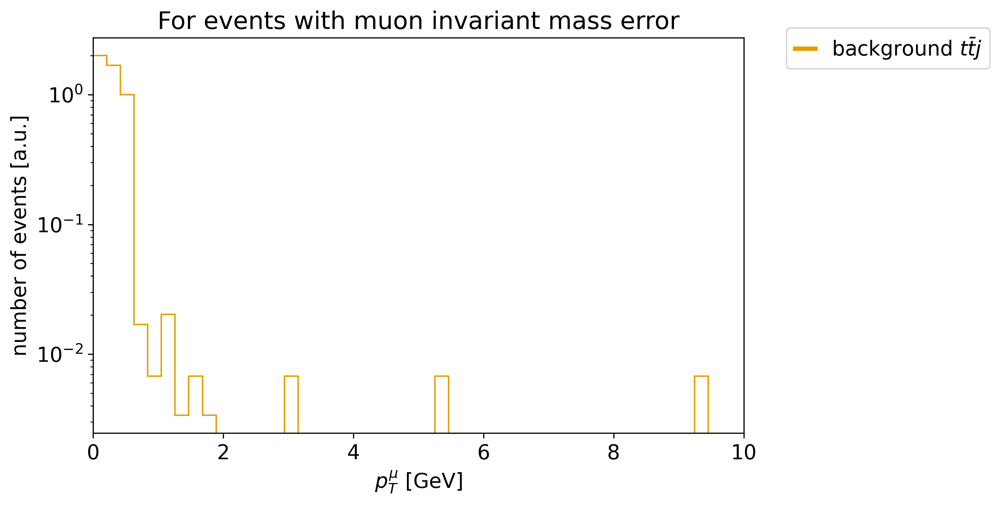

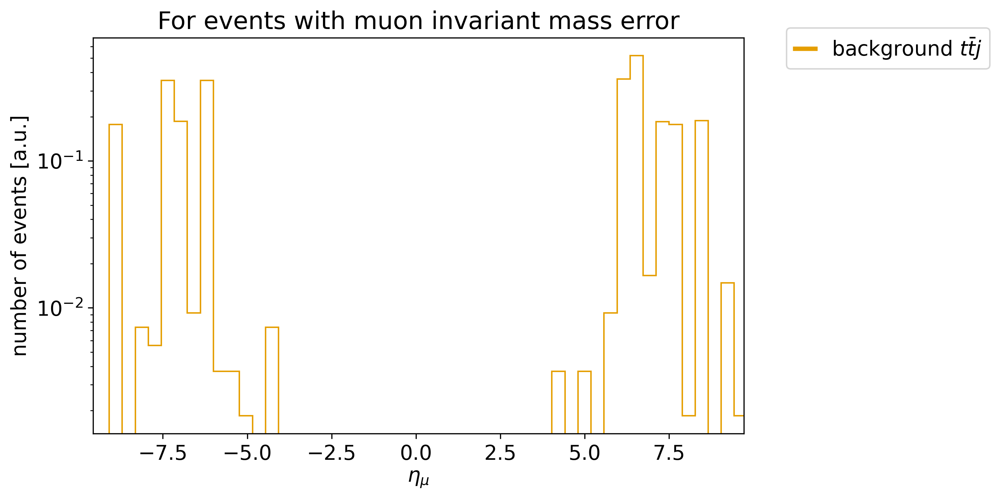

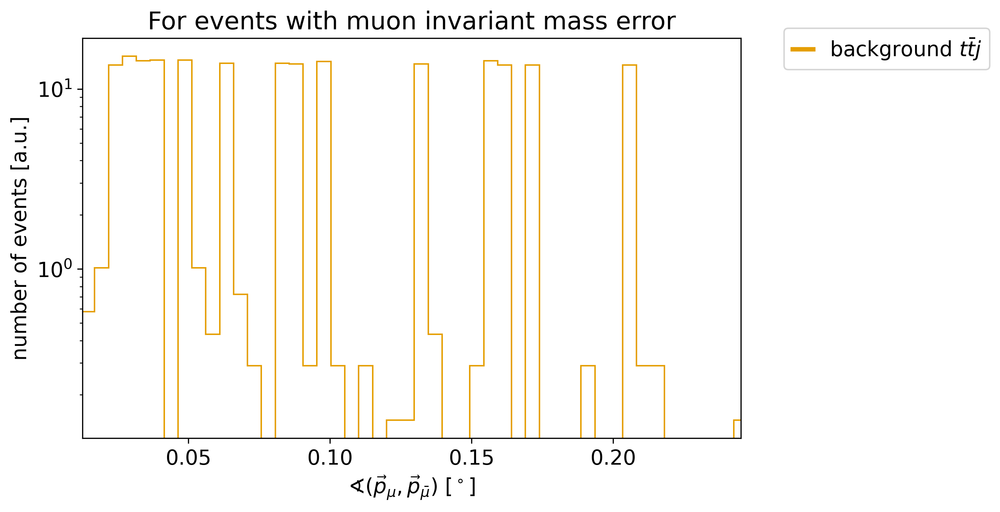

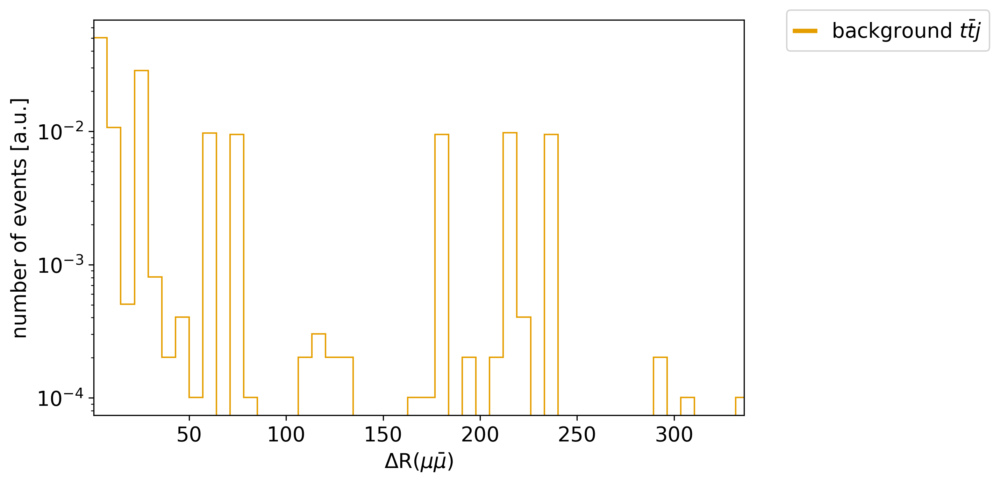

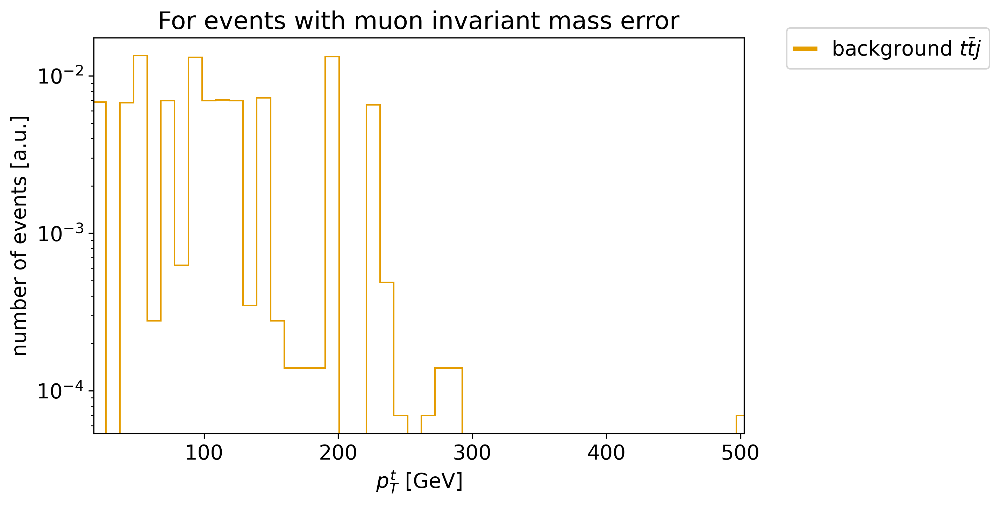

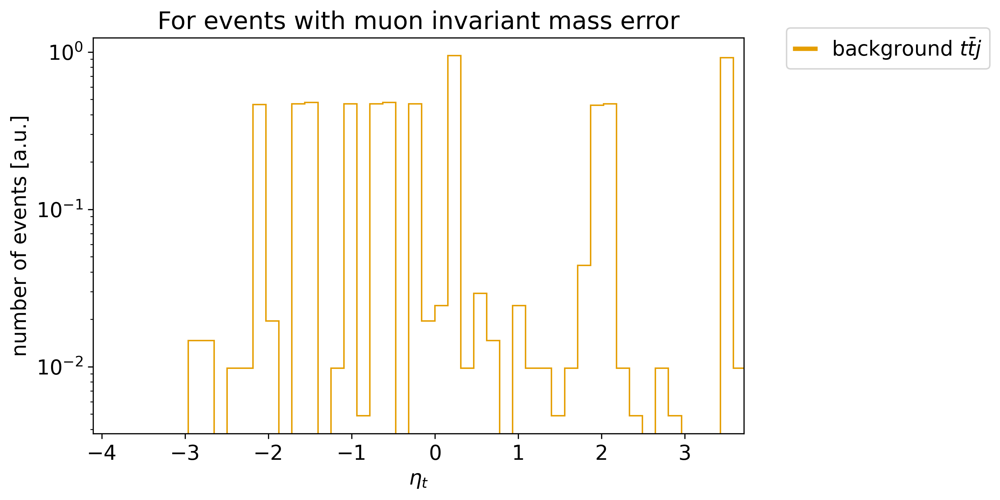

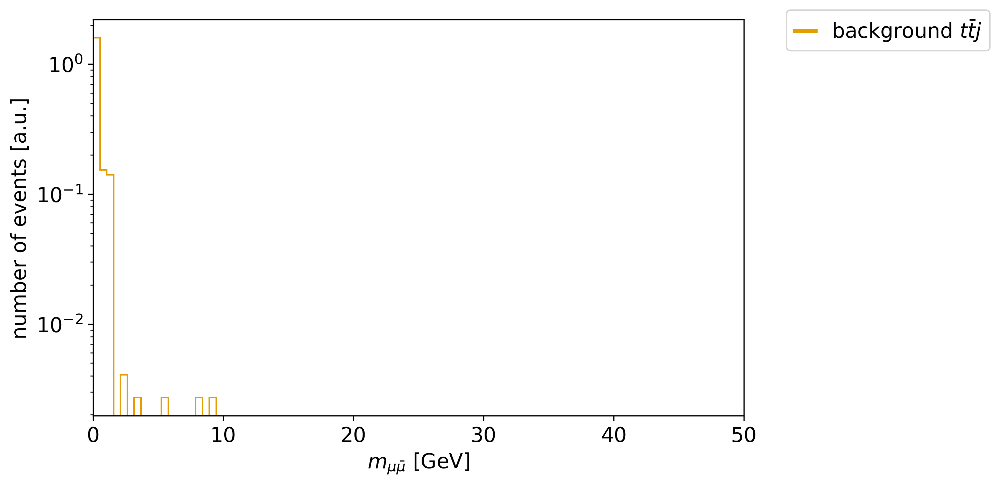

In [25]:
#mypl.hist1d(data("inv_mass",["antimuon","muon"],"ttj_masscheck"),labels_masscheck,dirLabel["mmumu"],nbins=120,customXlim=[0,120],log_scale=True)

mypl.hist1d(data("pT",["muon"],"ttj_masscheck"),labels_masscheck,dirLabel["pT_mu"],customXlim=[0,10],log_scale=True,title=title_masscheck)

mypl.hist1d(data("eta",["muon"],"ttj_masscheck"),labels_masscheck,dirLabel["eta_mu"],log_scale=True,title=title_masscheck)

mypl.hist1d(data("oA",["antimuon","muon"],"ttj_masscheck"),labels_masscheck,dirLabel["oA_muons"],log_scale = True,title=title_masscheck)

#mypl.hist1d(data("y",["muon"],"ttj_masscheck"),labels_masscheck,dirLabel["y_mu"],log_scale = True)

mypl.hist1d(data("deltaR",["antimuon","muon"],"ttj_masscheck"),labels_masscheck,dirLabel["deltaR_muons"],customXlim=[0,5],log_scale=True)

mypl.hist1d(data("pT",["top"],"ttj_masscheck"),labels_masscheck,dirLabel["pT_t"],log_scale=True,title=title_masscheck)

mypl.hist1d(data("eta",["top"],"ttj_masscheck"),labels_masscheck,dirLabel["eta_t"],log_scale=True,title=title_masscheck)

mypl.hist1d(data("inv_mass_from_angle",["antimuon","muon"],"ttj_masscheck"),labels_masscheck,dirLabel["mmumu"],nbins=100,customXlim=[0,50],log_scale=True)


# Muon Pair data

In [26]:
data_ttj_pairs = [dc.Dataset.from_txt_bkg("/eos/user/l/lrygaard/ttalp/ttj_cluster_runs/muon_data1/muon_data.txt",charge_req=-2)]

/eos/user/l/lrygaard/ttalp/ttj_cluster_runs/muon_data1/muon_data.txt read with [top, antitop, muon, antimuon] in 17528 Events.


In [27]:
data_ttj_pairs_nocut = data_ttj_pairs.copy()
# Make a cut for |eta|<2.5
sel = ((lambda x: abs(x)<2.5),"eta", ["muon"])
data_ttj_pairs = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pairs_nocut]
sel = ((lambda x: abs(x)<2.5),"eta", ["antimuon"])
data_ttj_pairs = [dc.Dataset.event_selection(ds,sel) for ds in data_ttj_pairs]

print(data_ttj_pairs)

labels_masscheck = [r'background $t\bar{t}j$']
title_pairs = "For events with muon pairs"

[This Dataset contains 7726 events.]


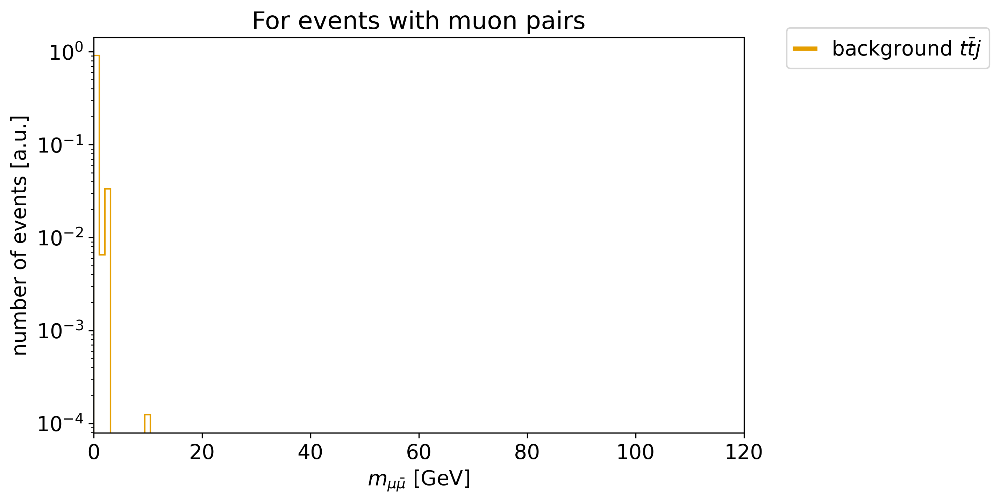

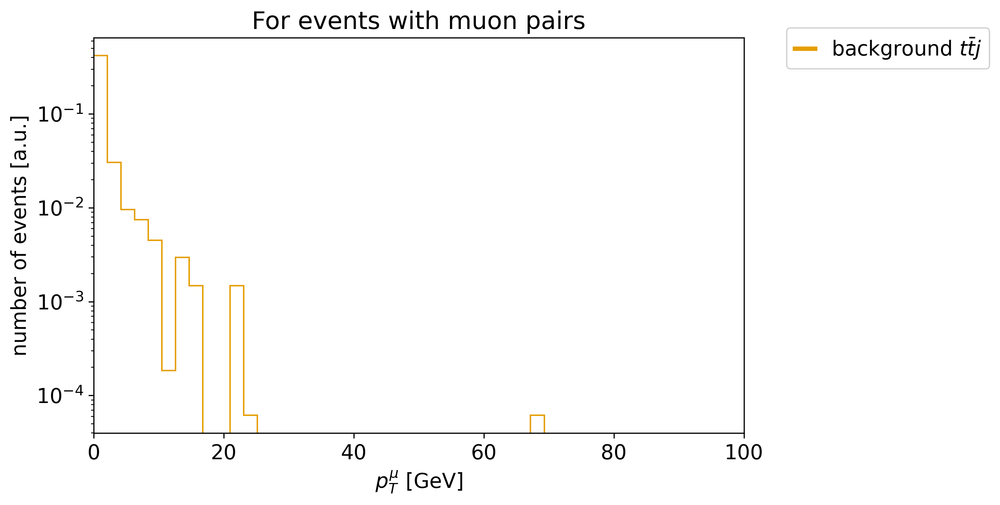

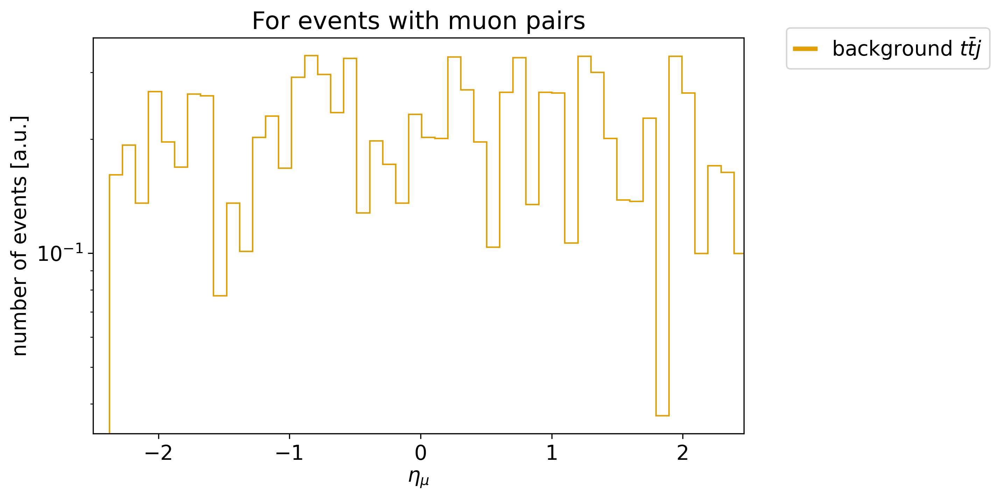

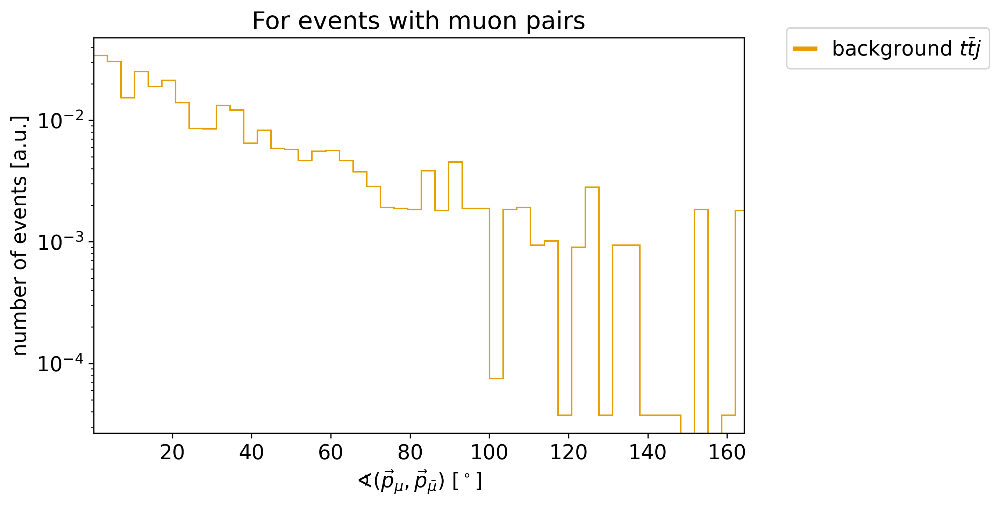

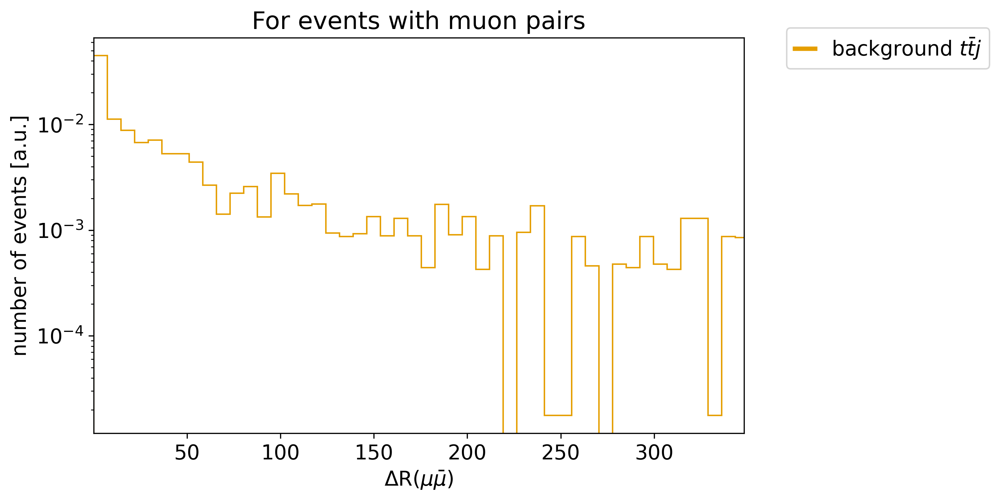

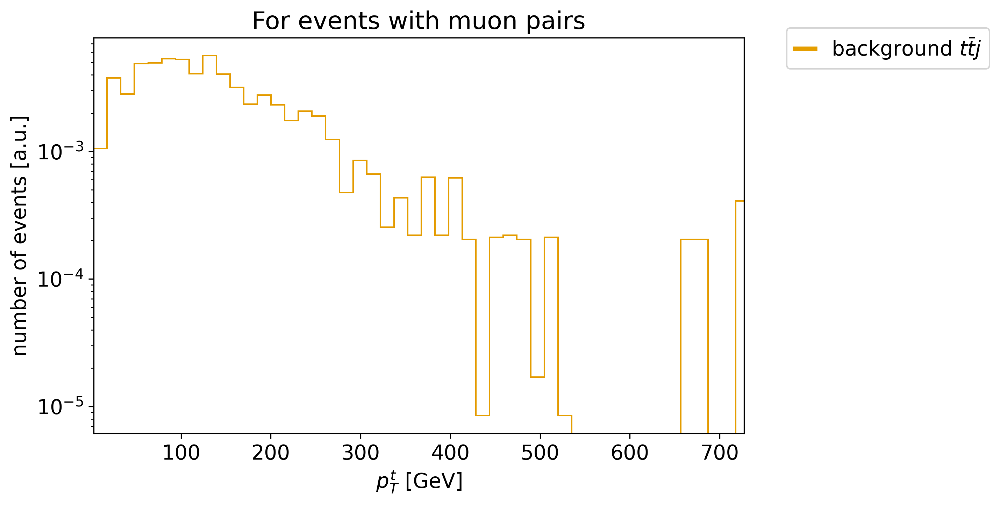

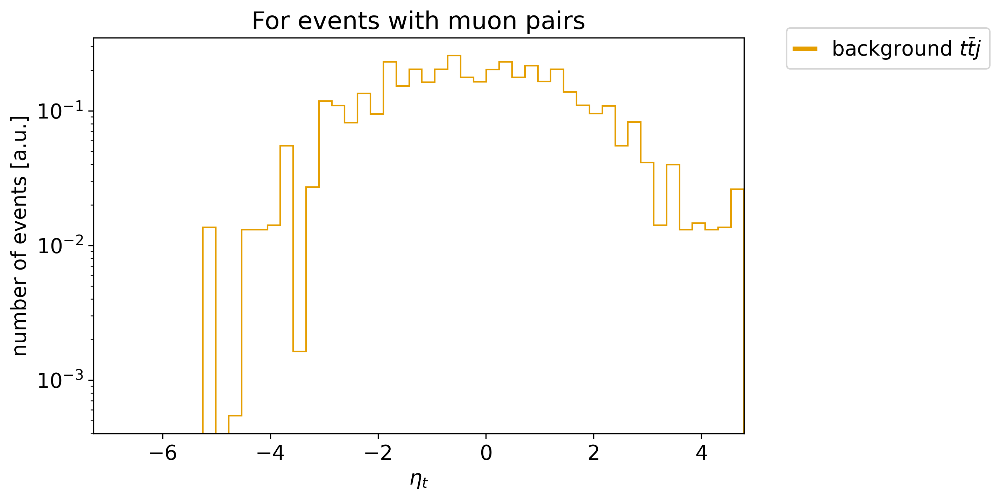

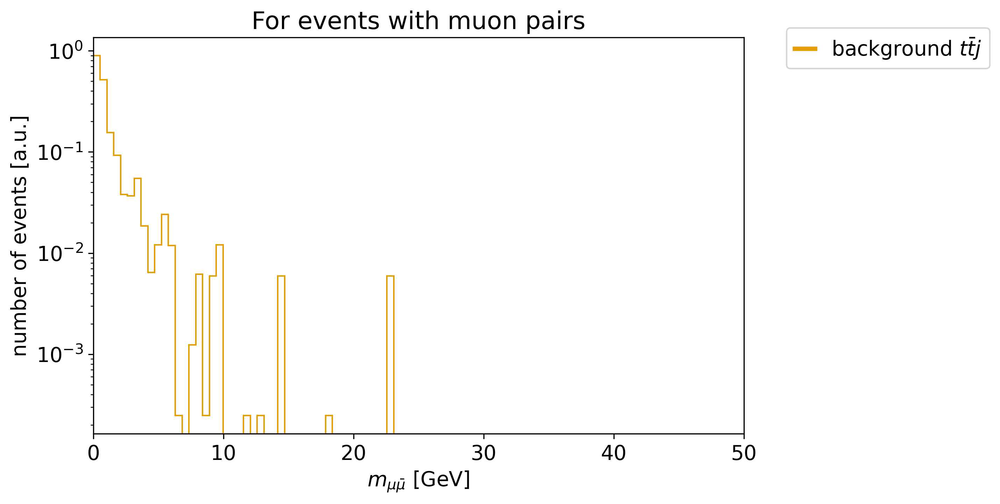

In [28]:
mypl.hist1d(data("inv_mass",["antimuon","muon"],"ttj_pairs"),labels_masscheck,dirLabel["mmumu"],nbins=120,customXlim=[0,120],log_scale=True,title=title_pairs)

mypl.hist1d(data("pT",["muon"],"ttj_pairs"),labels_masscheck,dirLabel["pT_mu"],customXlim=[0,100],log_scale=True,title=title_pairs)

mypl.hist1d(data("eta",["muon"],"ttj_pairs"),labels_masscheck,dirLabel["eta_mu"],log_scale=True,title=title_pairs)

mypl.hist1d(data("oA",["antimuon","muon"],"ttj_pairs"),labels_masscheck,dirLabel["oA_muons"],log_scale =True,title=title_pairs)

#mypl.hist1d(data("y",["muon"],"ttj_masscheck"),labels_masscheck,dirLabel["y_mu"],log_scale = True,title=title_pairs)

mypl.hist1d(data("deltaR",["antimuon","muon"],"ttj_pairs"),labels_masscheck,dirLabel["deltaR_muons"],log_scale=True,customXlim=[0,5],title=title_pairs)

mypl.hist1d(data("pT",["top"],"ttj_pairs"),labels_masscheck,dirLabel["pT_t"],log_scale=True,title=title_pairs)

mypl.hist1d(data("eta",["top"],"ttj_pairs"),labels_masscheck,dirLabel["eta_t"],log_scale=True,title=title_pairs)

mypl.hist1d(data("inv_mass_from_angle",["antimuon","muon"],"ttj_pairs"),labels_masscheck,dirLabel["mmumu"],nbins=100,customXlim=[0,50],log_scale=True,title=title_pairs)


# Other plots

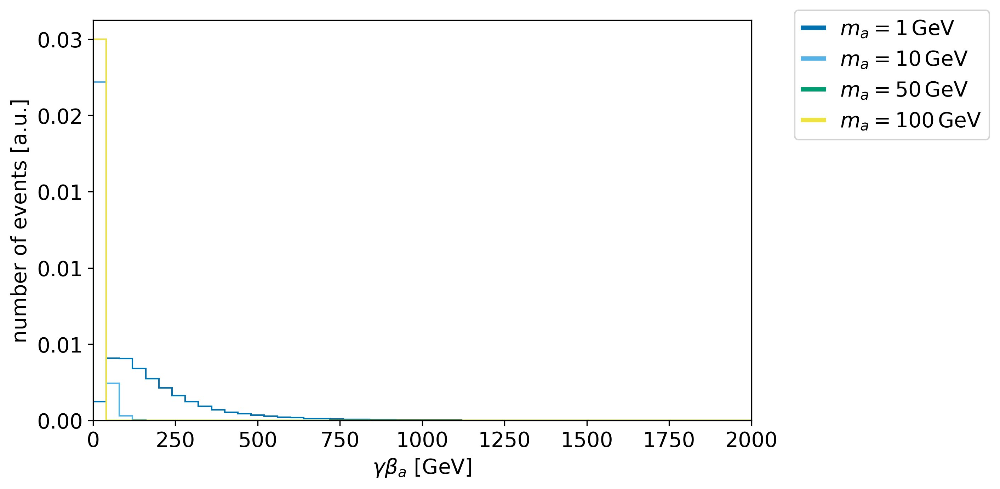

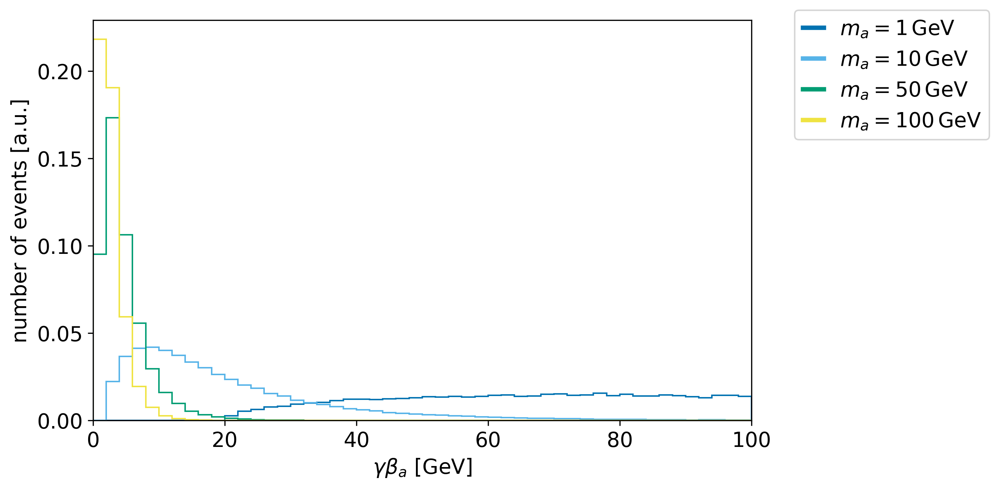

In [38]:
mypl.hist1d(data("boost",["alp"],"incl"),massLabels2,dirLabel["boost_a"],customXlim=[0,2000])
mypl.hist1d(data("boost",["alp"],"incl"),massLabels2,dirLabel["boost_a"],customXlim=[0,100])

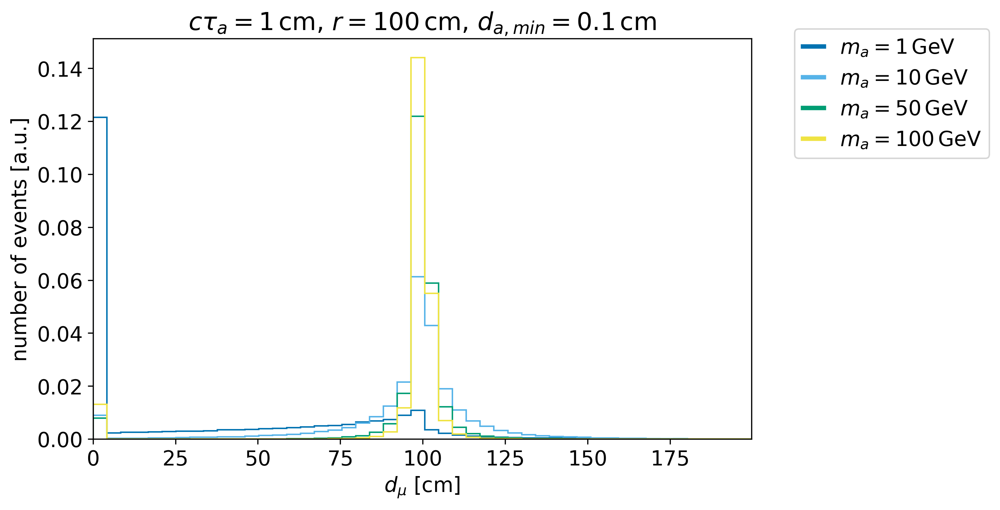

In [106]:
mypl.hist1d(data("track_from_ctau",["alp","muon"],"incl",radius=100,ctau=1,minimum_displacement=0.1),massLabels2,dirLabel["track_mu"],outputpath+"Tracklength_at_100_1_0p1.png", title=r"$c\tau_a=1\,$cm, $r=100\,$cm, $d_{a, min}=0.1\,$cm")

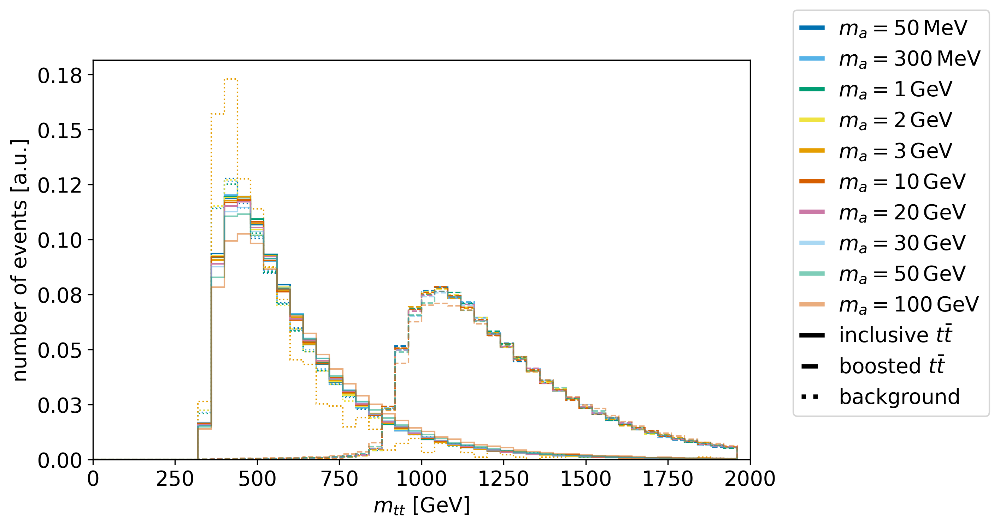

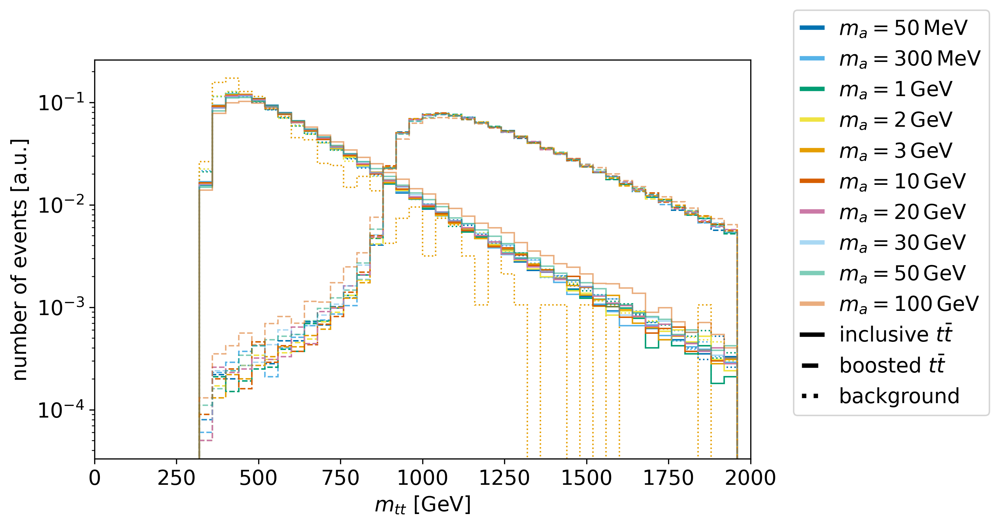

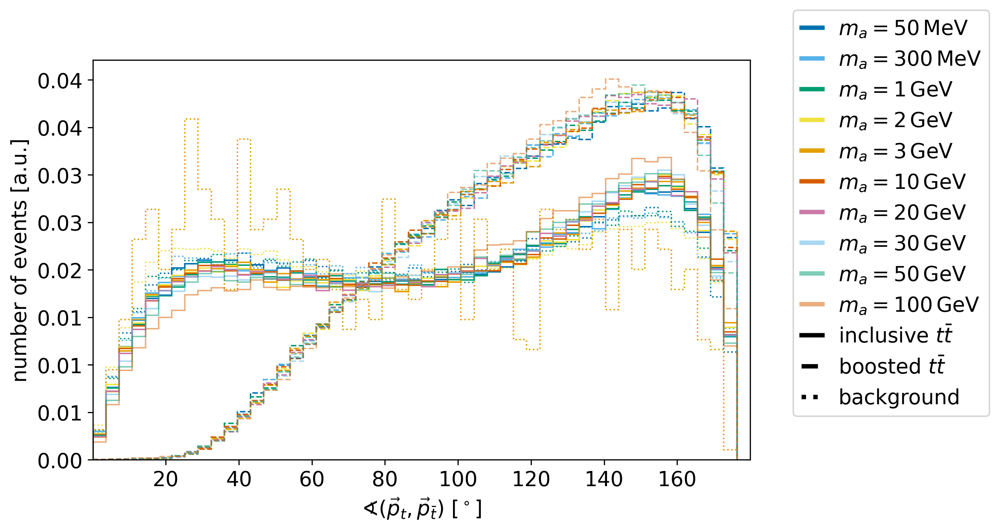

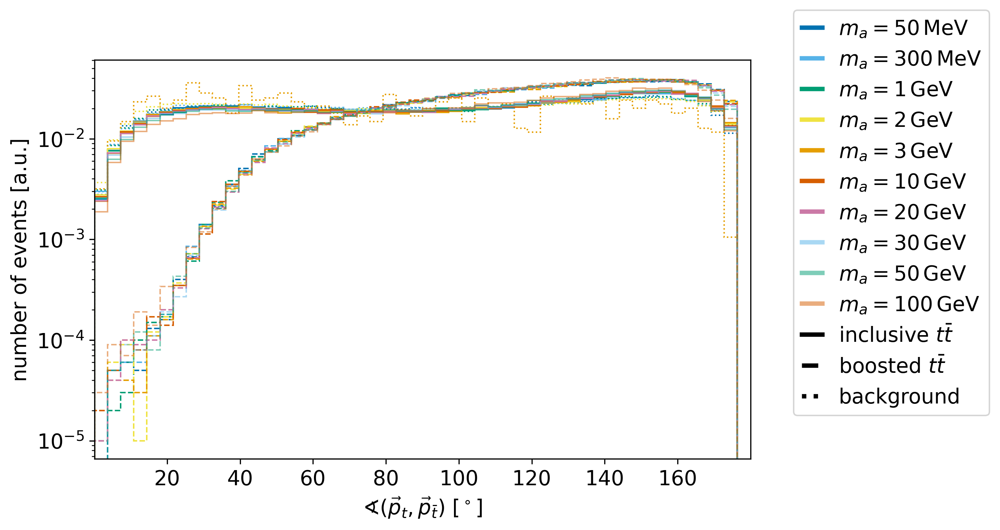

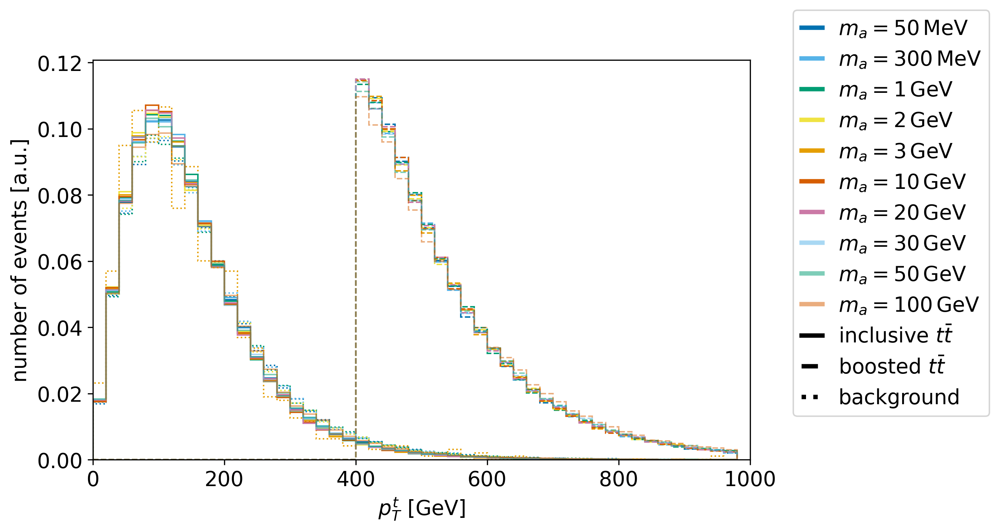

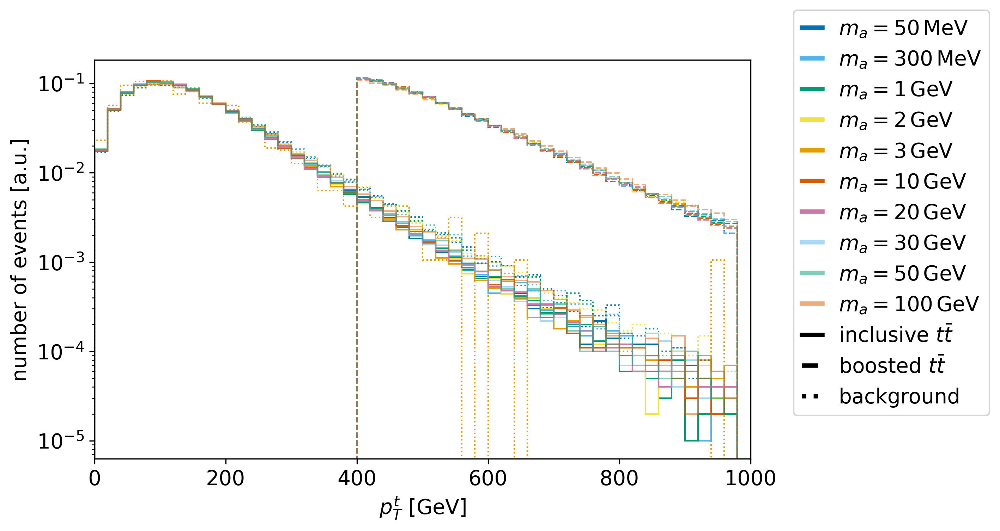

In [ ]:
# kinematics of the inclusive and boosted signal events and the ttmumu+ttj background events
mypl.hist1dcomp(data("inv_mass",["top","antitop"],"incl"), data("inv_mass",["top","antitop"],"boost"), data("inv_mass",["top","antitop"],"bkg"),massLabels,dirLabel["mtt"],outputpath+"mtt_cwb_ttj_lin.png",customXlim=[0,2000],customXlabels=labels_bkg, log_scale=False)
mypl.hist1dcomp(data("inv_mass",["top","antitop"],"incl"), data("inv_mass",["top","antitop"],"boost"), data("inv_mass",["top","antitop"],"bkg"),massLabels,dirLabel["mtt"],outputpath+"mtt_cwb_ttj_log.png",customXlim=[0,2000],customXlabels=labels_bkg, log_scale=True)
#mypl.hist1dcompden(data("inv_mass",["top","antitop"],"incl"),data("inv_mass",["top","antitop"],"bkg"),data("inv_mass",["top","antitop"],"ttj"),massLabels,dirLabel["mtt"],outputpath+"mtt_cwb_ttj_den.png",customXlim=[0,2000],customXlabels=labels_bkg)
mypl.hist1dcomp(data("oA",["top","antitop"],"incl"),data("oA",["top","antitop"],"boost"),data("oA",["top","antitop"],"bkg"),massLabels,dirLabel["oA_tat"],outputpath+"Angle_TopAntiTop_cwb_lin.png",customXlabels=labels_bkg)
mypl.hist1dcomp(data("oA",["top","antitop"],"incl"),data("oA",["top","antitop"],"boost"),data("oA",["top","antitop"],"bkg"),massLabels,dirLabel["oA_tat"],outputpath+"Angle_TopAntiTop_cwb_log.png",customXlabels=labels_bkg, log_scale = True)
#mypl.hist1dcomp(data("oA",["top","antitop"],"incl"),data("oA",["top","antitop"],"bkg"),data("oA",["top","antitop"],"ttj"),massLabels,dirLabel["oA_tat"],outputpath+"Angle_TopAntiTop_cwb_ttj.png",customXlabels=labels_bkg)
mypl.hist1dcomp(data("pT",["top"],"incl"),data("pT",["top"],"boost"),data("pT",["top"],"bkg"),massLabels,dirLabel["pT_t"],outputpath+"Top_pT_cwb_ttj_lin.png",customXlim=[0,1000],customXlabels=labels_bkg)
mypl.hist1dcomp(data("pT",["top"],"incl"),data("pT",["top"],"boost"),data("pT",["top"],"bkg"),massLabels,dirLabel["pT_t"],outputpath+"Top_pT_cwb_ttj_log.png",customXlim=[0,1000],customXlabels=labels_bkg, log_scale = True)
mypl.hist1dcomp(data("pT",["muon"],"incl"),data("pT",["muon"],"boost"),data("pT",["muon"],"bkg"),massLabels,dirLabel["pT_mu"],outputpath+"Muon_pT_cwb_lin.png",customXlim=[0,1000],customXlabels=labels_bkg)
mypl.hist1dcomp(data("pT",["muon"],"incl"),data("pT",["muon"],"boost"),data("pT",["muon"],"bkg"),massLabels,dirLabel["pT_mu"],outputpath+"Muon_pT_cwb_log.png",customXlim=[0,1000],customXlabels=labels_bkg, log_scale = True)
mypl.hist1dcomp(data("oA",["antimuon","muon"],"incl"),data("oA",["antimuon","muon"],"boost"),data("oA",["antimuon","muon"],"bkg"),massLabels,dirLabel["oA_muons"],outputpath+"Angle_Muons_cwb_lin.png",customXlabels=labels_bkg)
mypl.hist1dcomp(data("oA",["antimuon","muon"],"incl"),data("oA",["antimuon","muon"],"boost"),data("oA",["antimuon","muon"],"bkg"),massLabels,dirLabel["oA_muons"],outputpath+"Angle_Muons_cwb_log.png",customXlabels=labels_bkg, log_scale = True)